# Import libraries

In [1]:
from collections import Counter
from pathlib import Path

# Libraries for visualization
import matplotlib.pyplot as plt
import seaborn as sns

# Libraries for text and data processing
import nltk
import numpy as np
import pandas as pd
from PIL import Image
from tqdm import tqdm
from wordcloud import WordCloud
import ast
import re
import pyLDAvis
import pyLDAvis.lda_model
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.feature_extraction.text import TfidfVectorizer

# Load statistical libraries
from statsmodels.stats import diagnostic
from scipy import stats
import scipy.stats as stats
from scipy.stats import spearmanr


# Enable autoreload to automatically reload modified modules
%load_ext autoreload
%autoreload 2


# We will need some ntlk dependencies
nltk.download('stopwords', quiet=True)
nltk.download('wordnet', quiet=True)
nltk.download('punkt_tab', quiet=True)

True

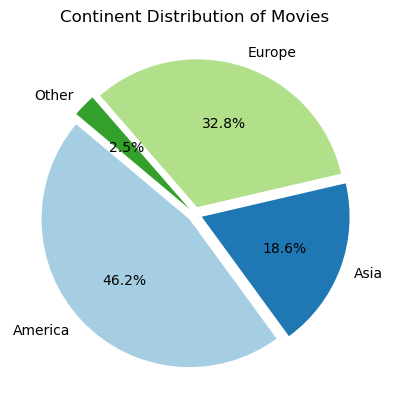
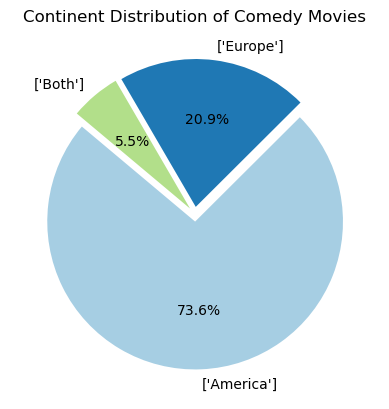

# Preprocessing of the Data

Before beginning the analysis, it's essential to construct a robust dataset that serves as a reliable foundation for our exploration and insights.

## CMU Movie Summary Corpus

The CMU Movie Summary Corpus serves as our primary dataset. It can be accessed through the following website: [CMU Movie Summary Corpus](https://www.cs.cmu.edu/~ark/personas/). Please note that MovieSummaries isn't pushed on our repo due to size issues. 


In [2]:
# Define the file paths
plot_summaries_path = r'..\MovieSummaries\plot_summaries.txt'
movie_metadata_path = r'..\MovieSummaries\movie.metadata.tsv'
character_metadata_path = r'..\MovieSummaries\character.metadata.tsv'

# Load plot summaries
plot_summaries = pd.read_csv(plot_summaries_path, sep='\t', header=None, names=['Wikipedia_ID', 'Plot_Summary'])

# Load movie metadata
movie_metadata = pd.read_csv(movie_metadata_path, sep='\t', header=None, names=['Wikipedia_ID', 'Freebase_ID', 'Movie_Name', 'Release_Date', 'Box_Office_Revenue', 'Runtime', 'Languages', 'Countries', 'Genres'])

# Load character metadata
character_metadata = pd.read_csv(character_metadata_path, sep='\t', header=None, names=['Wikipedia_ID', 'Freebase_ID', 'Release_Date', 'Character_Name', 'Actor_Birth_Date', 'Actor_Gender', 'Actor_Height', 'Actor_Ethnicity', 'Actor_Name', 'Actor_Age', 'Character_Actor_Freebase_ID', 'Character_Freebase_ID', 'Actor_Freebase_ID'])

display(movie_metadata.head(2) , movie_metadata.shape)

,Wikipedia_ID,Freebase_ID,Movie_Name,Release_Date,Box_Office_Revenue,Runtime,Languages,Countries,Genres
0,975900,/m/03vyhn,Ghosts of Mars,2001-08-24,14010832.0,98.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}","{""/m/01jfsb"": ""Thriller"", ""/m/06n90"": ""Science..."
1,3196793,/m/08yl5d,Getting Away with Murder: The JonBenét Ramsey ...,2000-02-16,NaN,95.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}","{""/m/02n4kr"": ""Mystery"", ""/m/03bxz7"": ""Biograp..."


(81741, 9)

### Treatment colomns Languages, Countries and Genres
The code loads a CSV file with movie metadata into a DataFrame, defining names for each column. The "Freebase_ID" column is removed, and the "Languages," "Countries," and "Genres" columns are converted into lists of values by extracting data from dictionary-like strings. Empty cells are replaced with "Unknown." Finally, the first few rows of the DataFrame are displayed for verification.

In [3]:
# Load movie metadata
movie_metadata = pd.read_csv(movie_metadata_path, sep='\t', header=None, names=['Wikipedia_ID', 'Freebase_ID', 'Movie_Name', 'Release_Date', 'Box_Office_Revenue', 'Runtime', 'Languages', 'Countries', 'Genres'])

# Drop the 'Freebase_ID' column
movie_metadata = movie_metadata.drop(columns=['Freebase_ID'], inplace=False)

# Explode the 'Languages' column
movie_metadata['Languages'] = movie_metadata['Languages'].apply(lambda x: list(eval(x).values()) if x != '{}' else ['Unknown'])

# Explode the 'Countries' column
movie_metadata['Countries'] = movie_metadata['Countries'].apply(lambda x: list(eval(x).values()) if x != '{}' else ['Unknown'])

# Explode the 'Genres' column
movie_metadata['Genres'] = movie_metadata['Genres'].apply(lambda x: list(eval(x).values()) if x != '{}' else ['Unknown'])

### Mapping Countries to Continents and Filtering for America and Europe

This code defines a dictionary to classify countries by continent, then uses a function to map each country to its respective continent. If a country does not match any defined continent, it is labeled as "Other." This mapping function is applied to the "Countries" column in the `movie_metadata` DataFrame to create a new column, "Continents." Finally, the DataFrame is filtered to retain only rows where the continent includes "America" or "Europe".

In [4]:
from src.utils.data_utils import map_country_list_to_continent

# Apply the mapping function to the 'Countries' column
movie_metadata['Continents'] = movie_metadata['Countries'].apply(lambda x: map_country_list_to_continent(x))

# Filter rows where 'Continents' contains 'America' or 'Europe'
movie_metadata = movie_metadata[movie_metadata['Continents'].apply(lambda x: 'America' in x or 'Europe' in x)]

In [5]:
from src.utils.data_utils import treat_continent

movie_metadata["Continents"] = movie_metadata["Continents"].apply(lambda x: treat_continent(x))

# Remove rows where the continent list size is greater than or equal to 3
movie_metadata = movie_metadata[movie_metadata["Continents"].apply(lambda x: len(x) < 3)]

# Display the updated value counts for the 'Continents' column
display(movie_metadata["Continents"].value_counts())

Continents
[America]             34779
[Europe]              18488
[Both]                 3000
[America, Asia]         456
[Europe, Asia]          366
[Europe, Africa]        195
[America, Oceania]      182
[Both, Asia]            130
[Europe, Oceania]        93
[America, Africa]        63
[Both, Oceania]          50
[Both, Africa]           35
Name: count, dtype: int64

### Filtering for Comedy Genre and Counting Occurrences

This code filters the movies to keep only those with the genre "Comedy." It sets other genres to `None`, then drops rows without "Comedy" in the "Genres" column. 

In [6]:
movie_metadata["Genres"] = movie_metadata["Genres"].apply(lambda x: x if 'Comedy' in x else None)

movie_metadata = movie_metadata.dropna(subset=["Genres"])

movie_metadata["Genres"].value_counts()

Genres
[Comedy]                                                                           1700
[Short Film, Silent film, Indie, Black-and-white, Comedy]                           547
[Drama, Comedy]                                                                     358
[Short Film, Comedy, Black-and-white]                                               252
[Comedy, Black-and-white]                                                           250
                                                                                   ... 
[Silent film, Melodrama, Indie, Comedy-drama, Black-and-white, Comedy]                1
[LGBT, Gay Interest, Indie, Gay, Satire, Comedy, Gay Themed, Romance Film]            1
[LGBT, Horror, Comedy-drama, Psychological thriller, Comedy, Black comedy]            1
[Period piece, Drama, Comedy, Film adaptation, Black comedy, Biographical film]       1
[Crime Fiction, Thriller, Comedy, Supernatural]                                       1
Name: count, Length: 6092

### Filling Missing Box Office Values and Verifying Changes


This code fills any `NaN` values in the "Box_Office_Revenue" column with 0. Then, it displays the first few rows and the shape of the DataFrame to verify the changes.

In [7]:
# Fill the NaN values in the Box_Office_Revenue column with 0
movie_metadata['Box_Office_Revenue'] = movie_metadata['Box_Office_Revenue'].fillna(0)

## Open Movie Database (OMBD)

In [8]:
# Load the OMDB API data
# Please note that we did not push this dataset on the repo because of size issues
omdb_data_path = r'..\MovieSummaries\movies_omdbapi.csv'
omdb_data = pd.read_csv(omdb_data_path)

# Display the first few rows of the dataframe
display(omdb_data.head(2), omdb_data.shape)

,Title,Year,Rated,Released,Runtime,Genre,Director,Writer,Actors,Plot,...,imdbRating,imdbVotes,imdbID,Type,DVD,BoxOffice,Production,Website,Response,totalSeasons
0,Ghosts of Mars,2001,R,24 Aug 2001,98 min,"Action, Horror, Sci-Fi",John Carpenter,"Larry Sulkis, John Carpenter","Natasha Henstridge, Ice Cube, Pam Grier","In 2176, a Martian police unit is sent to pick...",...,4.9,"58,722",tt0228333,movie,NaN,"$8,709,640",NaN,NaN,True,NaN
1,Getting Away with Murder: The JonBenet Ramsey ...,2000,NaN,16 Feb 2000,95 min,Drama,Edward Lucas,"Michael A. Graham, Ted Haimes","Alice Barrett, Rod Britt, Hildy Brooks","Six-year-old JonBenét Ramsey, whose body was f...",...,6.0,69,tt0245916,movie,NaN,NaN,NaN,NaN,True,NaN


(71544, 26)

In [9]:
# Let's inspect the columns of the OMDB dataset
print(omdb_data.columns)

Index(['Title', 'Year', 'Rated', 'Released', 'Runtime', 'Genre', 'Director',
       'Writer', 'Actors', 'Plot', 'Language', 'Country', 'Awards', 'Poster',
       'Ratings', 'Metascore', 'imdbRating', 'imdbVotes', 'imdbID', 'Type',
       'DVD', 'BoxOffice', 'Production', 'Website', 'Response',
       'totalSeasons'],
      dtype='object')


## Merging DataFrames and Dropping Unnecessary Columns

This code merges two DataFrames, movie_metadata and omdb_data, using an inner join on the "Movie_Name" column from movie_metadata and the "Title" column from omdb_data.Afterward, it removes unneeded columns ("Released," "Genre," "Title," "Language," "Country," and "Type") to keep only relevant information.

In [10]:
# Merge the two dataframes on the 'Movie_Name' column
merged_movie_metadata = pd.merge(movie_metadata, omdb_data, left_on='Movie_Name', right_on='Title', how='inner')

# Drop columns
merged_movie_metadata = merged_movie_metadata.drop(columns=["Released" , "Genre" , "Title" , "Language" , "Country" ,"Type"])

### Cleaning and Merging Box Office Revenue Data

This code combines revenue data from "Box_Office_Revenue" and "BoxOffice" to ensure complete, consistent values. It removes the dollar sign from "BoxOffice," converts it to a float, replaces 0s in "Box_Office_Revenue" with `NaN`, and fills missing values from "BoxOffice." The "BoxOffice" column is then dropped, leaving a unified "Box_Office_Revenue" column in float format. This process standardizes revenue data for further analysis.

In [ ]:
# Merge box office revenue columns
display(merged_movie_metadata[["Box_Office_Revenue","BoxOffice"]].head())

# Merge box office revenue columns
# Remove the '$' sign and convert the 'BoxOffice' column to float
merged_movie_metadata['BoxOffice'] = merged_movie_metadata['BoxOffice'].replace('[\$,]', '', regex=True).astype(float)

# Replace 0 values in 'Box_Office_Revenue' with NaN
merged_movie_metadata['Box_Office_Revenue'].replace(0, pd.NA, inplace=True)

# Fill missing values in 'Box_Office_Revenue' with values from 'BoxOffice'
merged_movie_metadata['Box_Office_Revenue'] = merged_movie_metadata['Box_Office_Revenue'].fillna(merged_movie_metadata['BoxOffice'])

# Drop the 'BoxOffice' column as it is now merged
merged_movie_metadata = merged_movie_metadata.drop(columns=['BoxOffice'])

# Display the first few rows to verify the changes
display(merged_movie_metadata[['Box_Office_Revenue']].head())


display(merged_movie_metadata["Box_Office_Revenue"].isna().sum())

# Verify if the 'Box_Office_Revenue' column contains only floats
is_float = merged_movie_metadata['Box_Office_Revenue'].apply(lambda x: isinstance(x, float)).all()
print(f"All values in 'Box_Office_Revenue' are floats: {is_float}")

<>:12: SyntaxWarning: invalid escape sequence '\$'
<>:12: SyntaxWarning: invalid escape sequence '\$'
C:\Users\41793\AppData\Local\Temp\ipykernel_8924\2065240096.py:12: SyntaxWarning: invalid escape sequence '\$'
  merged_movie_metadata['BoxOffice'] = merged_movie_metadata['BoxOffice'].replace('[\$,]', '', regex=True).astype(float)


,Box_Office_Revenue,BoxOffice
0,0.0,NaN
1,3600000.0,NaN
2,0.0,NaN
3,102272727.0,"$102,272,727"
4,0.0,"$69,171"


,Box_Office_Revenue
0,NaN
1,3600000.0
2,NaN
3,102272727.0
4,69171.0


8429

All values in 'Box_Office_Revenue' are floats: True


### Cleaning and Merging Runtime Data

This code standardizes the runtime data by removing unwanted characters and combining columns. First, digits are removed from "Runtime_y" to identify common patterns, and rows with invalid characters ('h' or 'S') are filtered out. The column is further cleaned by stripping "min" and converting values to float. Any missing values in "Runtime_x" are then filled using "Runtime_y," after which "Runtime_y" is dropped. Finally, "Runtime_x" is renamed to "Runtime" for clarity, ensuring all runtime data is consolidated and ready for analysis.

In [12]:
# Remove digits from the 'Runtime_y' column
runtime_counts = merged_movie_metadata['Runtime_y'].str.replace('\d+', '', regex=True).value_counts()

# Display the result
print(runtime_counts)

# Remove rows containing 'h' or 'S' in the 'Runtime_y' column
merged_movie_metadata = merged_movie_metadata[~merged_movie_metadata['Runtime_y'].str.contains('h|S', na=False)]

# Display the first few rows to verify the changes
display(merged_movie_metadata[['Runtime_y']].head())

# Remove digits from the 'Runtime_y' column
runtime_counts = merged_movie_metadata['Runtime_y'].str.replace('\d+', '', regex=True).value_counts()

# Display the result
print(runtime_counts)

Runtime_y
 min       13330
S min         31
 h  min        5
 h             1
Name: count, dtype: int64


,Runtime_y
0,105 min
1,106 min
2,70 min
3,139 min
4,83 min


Runtime_y
min    13330
Name: count, dtype: int64


In [13]:
# Merge runtime columns
# Remove 'min' from 'Runtime_y' and convert to float
merged_movie_metadata['Runtime_y'] = merged_movie_metadata['Runtime_y'].str.replace(' min', '').astype(float)

# Replace NaN values in 'Runtime_x' with values from 'Runtime_y'
merged_movie_metadata['Runtime_x'].fillna(merged_movie_metadata['Runtime_y'], inplace=True)

# Drop the 'Runtime_y' column as it is now merged
merged_movie_metadata = merged_movie_metadata.drop(columns=['Runtime_y'])

# Rename 'Runtime_x' to 'Runtime'
merged_movie_metadata.rename(columns={'Runtime_x': 'Runtime'}, inplace=True)

### Extracting and Organizing Ratings Data


This code extracts individual ratings from a JSON-like "Ratings" column. It defines a function to parse `ratings_str`, converting it to a dictionary of ratings by source (e.g., IMDb, Rotten Tomatoes). This function is applied to create a "Ratings_Dict" column, from which specific ratings are extracted into separate columns: "Internet_Movie_Database_Rating," "Rotten_Tomatoes_Rating," and "Metacritic_Rating." 

In [14]:
from src.utils.data_utils import extract_awards

# Apply the function to the Awards column and create new columns
merged_movie_metadata[['Oscar', 'Nomination_Awards', 'Win_Awards']] = merged_movie_metadata['Awards'].apply(lambda x: pd.Series(extract_awards(x)))

### Extracting, Normalizing, and Verifying Ratings Data



This code extracts and standardizes movie ratings to a 10-point scale. Initially, it parses the "Ratings" column to create a dictionary of ratings by source (IMDb, Rotten Tomatoes, Metacritic). Each rating source is extracted into separate columns, and a function then normalizes the values to a scale of 10, converting percentages and different scales as needed. The transformed columns are verified to ensure all values are floats and below 10, confirming the consistency of the rating data for analysis.

In [15]:
from src.utils.data_utils import extract_ratings

# Apply the function to the Ratings column
merged_movie_metadata['Ratings_Dict'] = merged_movie_metadata['Ratings'].apply(extract_ratings)

# Extract ratings from different sources
merged_movie_metadata['Internet_Movie_Database_Rating'] = merged_movie_metadata['Ratings_Dict'].apply(lambda x: x.get('Internet Movie Database', None))
merged_movie_metadata['Rotten_Tomatoes_Rating'] = merged_movie_metadata['Ratings_Dict'].apply(lambda x: x.get('Rotten Tomatoes', None))
merged_movie_metadata['Metacritic_Rating'] = merged_movie_metadata['Ratings_Dict'].apply(lambda x: x.get('Metacritic', None))

# Drop the temporary Ratings_Dict column
merged_movie_metadata = merged_movie_metadata.drop(columns=['Ratings_Dict'])

# Display the first few rows to verify the changes
display(merged_movie_metadata[['Movie_Name', 'Internet_Movie_Database_Rating', 'Rotten_Tomatoes_Rating', 'Metacritic_Rating']].head())

,Movie_Name,Internet_Movie_Database_Rating,Rotten_Tomatoes_Rating,Metacritic_Rating
0,The Gangsters,5.9/10,None,None
1,Alexander's Ragtime Band,6.8/10,83%,None
2,Contigo y aquí,None,None,None
3,Mary Poppins,7.8/10,97%,88/100
4,White on Rice,6.1/10,45%,45/100


In [16]:
from src.utils.data_utils import convert_to_scale_of_10

# Apply the function to the rating columns
merged_movie_metadata['Internet_Movie_Database_Rating'] = merged_movie_metadata['Internet_Movie_Database_Rating'].apply(convert_to_scale_of_10)
merged_movie_metadata['Rotten_Tomatoes_Rating'] = merged_movie_metadata['Rotten_Tomatoes_Rating'].apply(convert_to_scale_of_10)
merged_movie_metadata['Metacritic_Rating'] = merged_movie_metadata['Metacritic_Rating'].apply(convert_to_scale_of_10)

In [17]:
merged_movie_metadata['Metacritic_Rating'] = merged_movie_metadata['Metacritic_Rating'] / 100

# Display the first few rows to verify the changes
display(merged_movie_metadata[['Movie_Name', 'Internet_Movie_Database_Rating', 'Rotten_Tomatoes_Rating', 'Metacritic_Rating']].head())

,Movie_Name,Internet_Movie_Database_Rating,Rotten_Tomatoes_Rating,Metacritic_Rating
0,The Gangsters,5.9,NaN,NaN
1,Alexander's Ragtime Band,6.8,8.3,NaN
2,Contigo y aquí,NaN,NaN,NaN
3,Mary Poppins,7.8,9.7,8.8
4,White on Rice,6.1,4.5,4.5


In [18]:
# Verify that the columns contain only numbers less than 10 and are floats
columns_to_check = ['Internet_Movie_Database_Rating', 'Rotten_Tomatoes_Rating', 'Metacritic_Rating']
for column in columns_to_check:
    all_less_than_10 = merged_movie_metadata[column].apply(lambda x: x <= 10 if pd.notna(x) else True).all()
    all_floats = merged_movie_metadata[column].apply(lambda x: isinstance(x, float) if pd.notna(x) else True).all()
    print(f"All values in '{column}' are less than 10: {all_less_than_10}")
    print(f"All values in '{column}' are floats: {all_floats}")

All values in 'Internet_Movie_Database_Rating' are less than 10: True
All values in 'Internet_Movie_Database_Rating' are floats: True
All values in 'Rotten_Tomatoes_Rating' are less than 10: True
All values in 'Rotten_Tomatoes_Rating' are floats: True
All values in 'Metacritic_Rating' are less than 10: True
All values in 'Metacritic_Rating' are floats: True


### Classifying Age Ratings (Rated)

This code classifies movie age ratings into broader categories. It defines a function, classifier_age, which assigns ratings to specific groups: "All Audiences (TP)," "Recommended Parental Agreement (AP)," "13+," "16+," "18+," and "Not Rated." Using predefined lists of ratings, it categorizes each entry in the "Rated" column of merged_movie_metadata.

In [19]:
from src.utils.data_utils import classifier_age

merged_movie_metadata["Rated"].value_counts()

merged_movie_metadata["Rated"] = merged_movie_metadata["Rated"].apply(classifier_age)

### Classifying Comedy Subgenres

Une nouvelle classification des genres inclut désormais des sous-genres de comédie, comme la tragi-comédie et la satire. Cette section crée des fonctions pour générer des sous-genres combinés, par exemple "Comedy_Romance" pour "romance" et "romantic".

In [20]:
from src.utils.data_utils import determine_types , simplify_continent

### Load the datamerged

In [22]:
# Load the CSV file
merged_movie_metadata = pd.read_csv('data/AX1.csv')

# Convert the elements of the 'comedy_genres' column to a list of strings
merged_movie_metadata['comedy_genres'] = merged_movie_metadata['comedy_genres'].apply(lambda x: eval(x) if isinstance(x, str) else x)

### Loading the Merged DataFrame for rating analysis

In [23]:
dataset = pd.read_csv('data/merged_movie_metadata.csv')

# Drop duplicated lines
dataset_new = dataset.drop_duplicates()

# Display the shape of the DataFrame after removing duplicates
dataset_new.reset_index(drop=True, inplace=True)
dataset_new.shape

dataset_Genre_Cleaned = dataset_new.copy(deep=False)


# Apply the determine_types function to the 'Genres' column of the dataset
dataset_Genre_Cleaned['Types'] = dataset_Genre_Cleaned['Genres'].apply(determine_types)

# Display the first few rows to verify the new column
dataset_Genre_Cleaned['Types'].explode().value_counts()

dataset_Genre_Cleaned['Continents'] = dataset_Genre_Cleaned['Continents'].apply(lambda x: simplify_continent(ast.literal_eval(x)))

Visualizing Nan Values

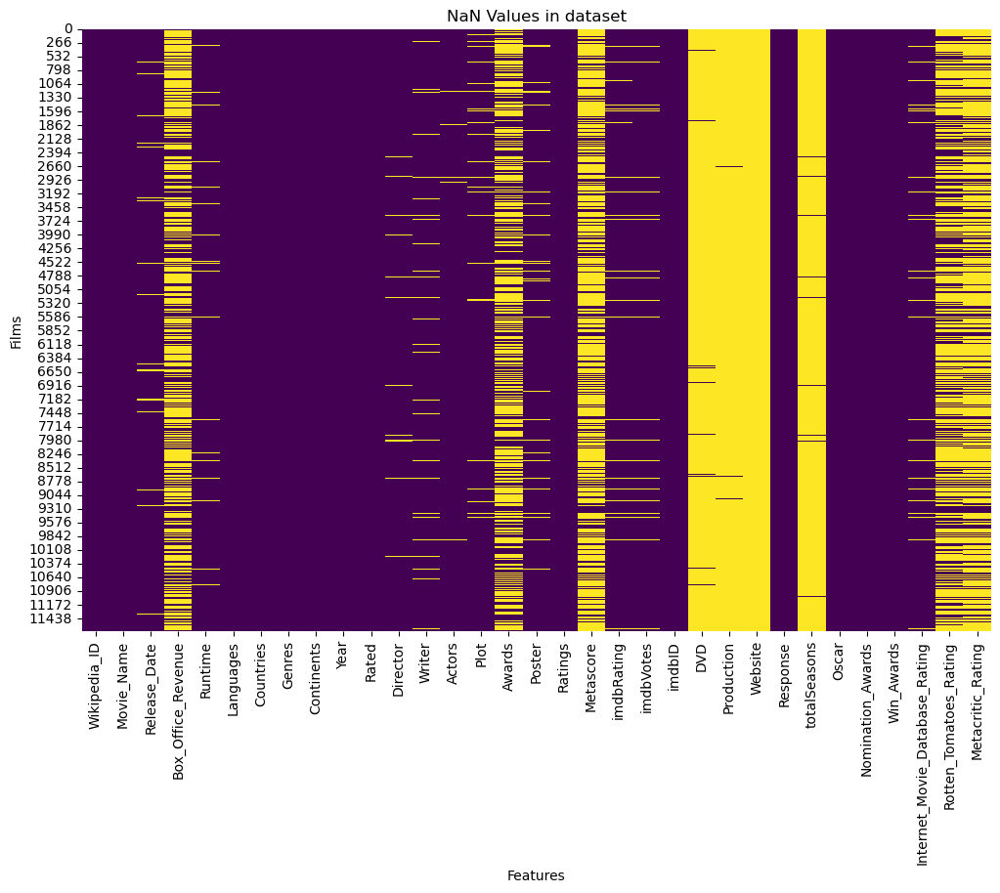

In [24]:
# Plot the NaN values in the feature matrix:
nan_mask_dropped = pd.isna(dataset_new)
plt.figure(figsize=(12, 8))
sns.heatmap(nan_mask_dropped, cbar=False, cmap='viridis')
plt.title('NaN Values in dataset')
plt.xlabel('Features')
plt.ylabel('Films')
plt.show()

# <h1 style="text-align:center; color: #FF6347;">AXE 1 : Commercial and Critical Success: A Comparative Study of Comedy Films in Europe and America 🎬🌍🇪🇺🇺🇸</h1>

This project examines the relationship between commercial success (box office) and critical acclaim (awards, ratings) specifically for comedy films in Europe versus those in America. By using OMDB data on revenues, ratings, and awards, we aim to analyze how these factors interact and differ by geographic context. The goal is to uncover the dynamics of success in the comedy genre within the global film industry, identifying what contributes to making a comedy film both profitable and critically acclaimed.

# Popularity vs. Quality: A Comparative Study of Box Office and Ratings


This code analyzes box office revenue for various comedy subgenres across different continents (America, Europe, and combined). It begins by cleaning and preparing the data, then visualizes revenue distributions by continent through histograms and comparative plots. Descriptive statistics are calculated for each continent. The code tests several statistical distributions to fit the data and identifies the best one. It also examines the most profitable comedy subgenres by continent. Finally, it evaluates correlations between box office revenue and critic ratings (IMDb, Rotten Tomatoes, Metacritic) for each continent using Spearman correlation.

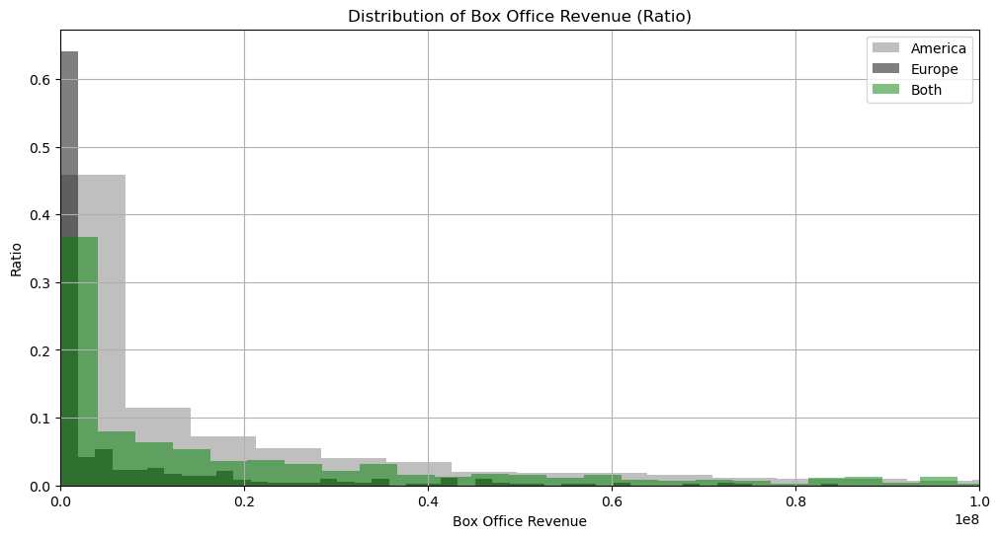

,Mean,Median,Standard Deviation,Q1,Q3
America,4.215332e+07,9600000.0,9.358275e+07,1228108.0,37591674.00
Europe,1.014050e+07,596858.0,2.982646e+07,87859.5,6740334.50
Both,4.135660e+07,11245111.0,7.896562e+07,969703.0,44369854.25


In [25]:
# Ensure the 'Box_Office_Revenue' column contains valid float values
merged_movie_metadata['Box_Office_Revenue'] = pd.to_numeric(merged_movie_metadata['Box_Office_Revenue'], errors='coerce')

# Drop rows with NaN values in the 'Box_Office_Revenue' column
revenue_data = merged_movie_metadata.dropna(subset=['Box_Office_Revenue'])

# Define the continents to plot
continents = ['America', 'Europe', 'Both']

# Create a single plot
plt.figure(figsize=(12, 6))

# Plot the histogram for each continent
for continent, color in zip(continents, ['grey', 'black', 'green']):
    continent_data = revenue_data[revenue_data['Continents'].apply(lambda x: continent in x)]
    total_count = len(continent_data)

    plt.hist(continent_data['Box_Office_Revenue'], bins=150, range=(0, continent_data['Box_Office_Revenue'].max()), 
             color=color, alpha=0.5, label=continent, weights=[1/total_count]*total_count)

# Add a title and labels
plt.title('Distribution of Box Office Revenue (Ratio)')
plt.xlabel('Box Office Revenue')
plt.xlim(0, 1e8)
plt.ylabel('Ratio')

# Add a legend
plt.legend()

# Activate grid
plt.grid(True)

# Display the plot
plt.show()

# Calculate basic statistics for Box Office Revenue for each continent
continent_stats = {}
for continent in continents:
    continent_data = revenue_data[revenue_data['Continents'].apply(lambda x: continent in x)]
    mean_revenue = continent_data['Box_Office_Revenue'].mean()
    median_revenue = continent_data['Box_Office_Revenue'].median()
    std_revenue = continent_data['Box_Office_Revenue'].std()
    q1_revenue = continent_data['Box_Office_Revenue'].quantile(0.25)
    q3_revenue = continent_data['Box_Office_Revenue'].quantile(0.75)
    continent_stats[continent] = {
        'Mean': mean_revenue,
        'Median': median_revenue,
        'Standard Deviation': std_revenue,
        'Q1': q1_revenue,
        'Q3': q3_revenue
    }

# Convert the dictionary to a DataFrame for better visualization
continent_stats_df = pd.DataFrame(continent_stats).T

# Display the DataFrame
display(continent_stats_df)

American films generate significantly higher average box office revenues (~42.2M) compared to European films (~10.1M). In Europe, the much lower median (~596K vs. ~9.6M in the U.S.) indicates a high proportion of low-revenue films, reflecting an asymmetric distribution. The high standard deviation for American films reveals substantial variability, driven by a few high-budget blockbusters, whereas in Europe, the lower standard deviation  shows a revenue distribution more concentrated around modest values.

In [26]:
# Load box office revenue data into a list
box_office_revenues = merged_movie_metadata['Box_Office_Revenue'].dropna().values

# Define a list of distributions to test
distributions = ['lognorm', 'expon', 'gamma', 'norm', 'pareto']

# Store the results
results = []

# Fit each distribution and evaluate the goodness of fit
for distribution in distributions:
    dist = getattr(stats, distribution)
    params = dist.fit(box_office_revenues)
    
    # Calculate goodness of fit using the Kolmogorov-Smirnov test
    ks_stat, ks_p_value = stats.kstest(box_office_revenues, distribution, args=params)
    
    # Calculate the log-likelihood
    log_likelihood = np.sum(dist.logpdf(box_office_revenues, *params))
    
    results.append({
        'distribution': distribution,
        'params': params,
        'ks_stat': ks_stat,
        'ks_p_value': ks_p_value,
        'log_likelihood': log_likelihood
    })

# Identify the best-fitting distribution based on the lowest KS statistic
best_fit = min(results, key=lambda x: x['ks_stat'])

# Display the scores for each distribution
for result in results:
    print(f"Distribution: {result['distribution']}")
    print(f"  Params: {result['params']}")
    print(f"  KS Statistic: {result['ks_stat']}")
    print(f"  KS p-value: {result['ks_p_value']}")
    print(f"  Log-Likelihood: {result['log_likelihood']}")
    print()

print(f"The best-fitting distribution is {best_fit['distribution']} "f"with a KS Statistic of {best_fit['ks_stat']} and a Log-Likelihood of {best_fit['log_likelihood']}.")

Distribution: lognorm
  Params: (2.7787697844231296, 109.75647745778906, 4255391.84357391)
  KS Statistic: 0.08491247516145217
  KS p-value: 4.340930765948154e-27
  Log-Likelihood: -75191.62410967087

Distribution: expon
  Params: (211.0, 38224063.8860372)
  KS Statistic: 0.3292962959739223
  KS p-value: 0.0
  Log-Likelihood: -78395.27030713914

Distribution: gamma
  Params: (0.3481448890122862, 1103690626.500352, 7.121602910510014e-24)
  KS Statistic: 1.0
  KS p-value: 0.0
  Log-Likelihood: -inf

Distribution: norm
  Params: (38224274.8860372, 87455231.87730695)
  KS Statistic: 0.33103026800755275
  KS p-value: 0.0
  Log-Likelihood: -83689.58177278243

Distribution: pareto
  Params: (0.4653855577950255, -1115111.1076378457, 1115322.1076378454)
  KS Statistic: 0.12097993743218394
  KS p-value: 1.2602664194975612e-54
  Log-Likelihood: -75759.25520174304

The best-fitting distribution is lognorm with a KS Statistic of 0.08491247516145217 and a Log-Likelihood of -75191.62410967087.


It is entirely expected for the log-normal distribution to be the best fit for box office revenues, as it effectively represents distributions where the majority of values are low but with some high extreme values.

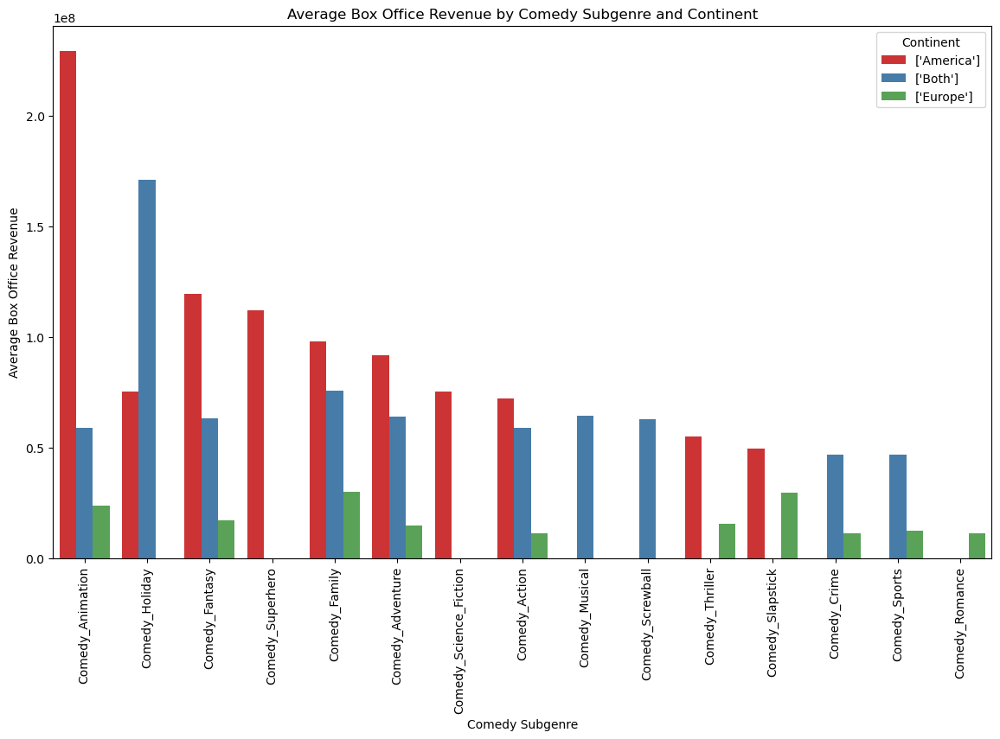

In [27]:
# Remove rows with 0 or NaN in the 'Box_Office_Revenue' column
merged_movie_metadata1 = merged_movie_metadata[merged_movie_metadata['Box_Office_Revenue'].notna() & (merged_movie_metadata['Box_Office_Revenue'] != 0)]

# Calculate average box office revenue by comedy subgenre for each continent
average_revenue_by_genre_continent = merged_movie_metadata1.explode('comedy_genres').groupby(['comedy_genres', 'Continents'])['Box_Office_Revenue'].mean().reset_index()

# Identify the most popular comedy subgenres in each continent
top_genres_by_continent = average_revenue_by_genre_continent.sort_values(by='Box_Office_Revenue', ascending=False).groupby('Continents').head(10)

# Create a comparative barplot
plt.figure(figsize=(14, 8))
sns.barplot(data=top_genres_by_continent, x='comedy_genres', y='Box_Office_Revenue', hue='Continents', palette='Set1')

# Add a title and label the axes
plt.title('Average Box Office Revenue by Comedy Subgenre and Continent')
plt.xlabel('Comedy Subgenre')
plt.ylabel('Average Box Office Revenue')
plt.xticks(rotation=90)
plt.legend(title='Continent')

# Display
plt.show()

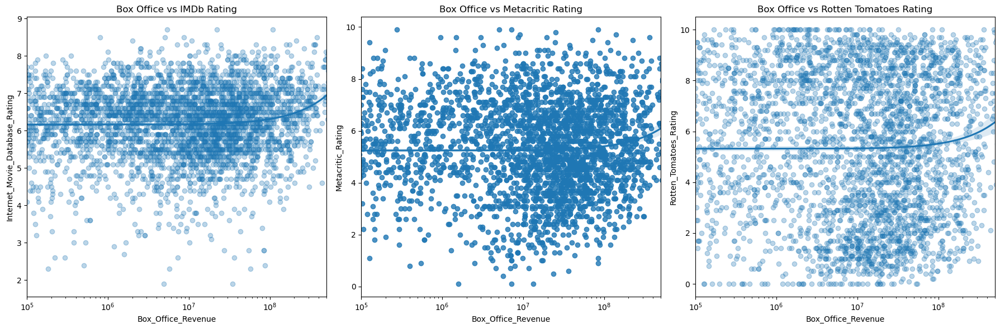

In [28]:
# Filter the data to include only rows with non-null values for Box_Office_Revenue and at least one of the ratings
filtered_data = merged_movie_metadata.dropna(subset=['Box_Office_Revenue', 'Internet_Movie_Database_Rating', 'Rotten_Tomatoes_Rating', 'Metacritic_Rating'], how='all')

# Create a figure with 3 subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Create a jointplot for 'Box_Office_Revenue' and 'Internet_Movie_Database_Rating' with a logarithmic scale and transparency
sns.regplot(
    data=filtered_data, x='Box_Office_Revenue', y='Internet_Movie_Database_Rating', ax=axes[0],
    scatter_kws={'alpha':0.3}
)
axes[0].set_xscale("log")
axes[0].set_xlim(1e5, 0.5e9)
axes[0].set_title('Box Office vs IMDb Rating')

# Create a hexbin plot for 'Box_Office_Revenue' and 'Metacritic_Rating'
sns.regplot(
    data=filtered_data, x='Box_Office_Revenue', y='Metacritic_Rating', ax=axes[1]
)
axes[1].set_xscale("log")
axes[1].set_xlim(1e5, 0.5e9)
axes[1].set_title('Box Office vs Metacritic Rating')

# Create a jointplot for 'Box_Office_Revenue' and 'Rotten_Tomatoes_Rating' with a logarithmic scale
sns.regplot(
    data=filtered_data, x='Box_Office_Revenue', y='Rotten_Tomatoes_Rating', ax=axes[2],
    scatter_kws={'alpha':0.3}
)
axes[2].set_xscale("log")
axes[2].set_xlim(1e5, 0.5e9)
axes[2].set_title('Box Office vs Rotten Tomatoes Rating')

# Display
plt.tight_layout()
plt.show()

For a relationship between box office and score, Spearman correlation is more appropriate because it is less affected by outliers and better suited to non-linear relationships and asymmetric distributions.

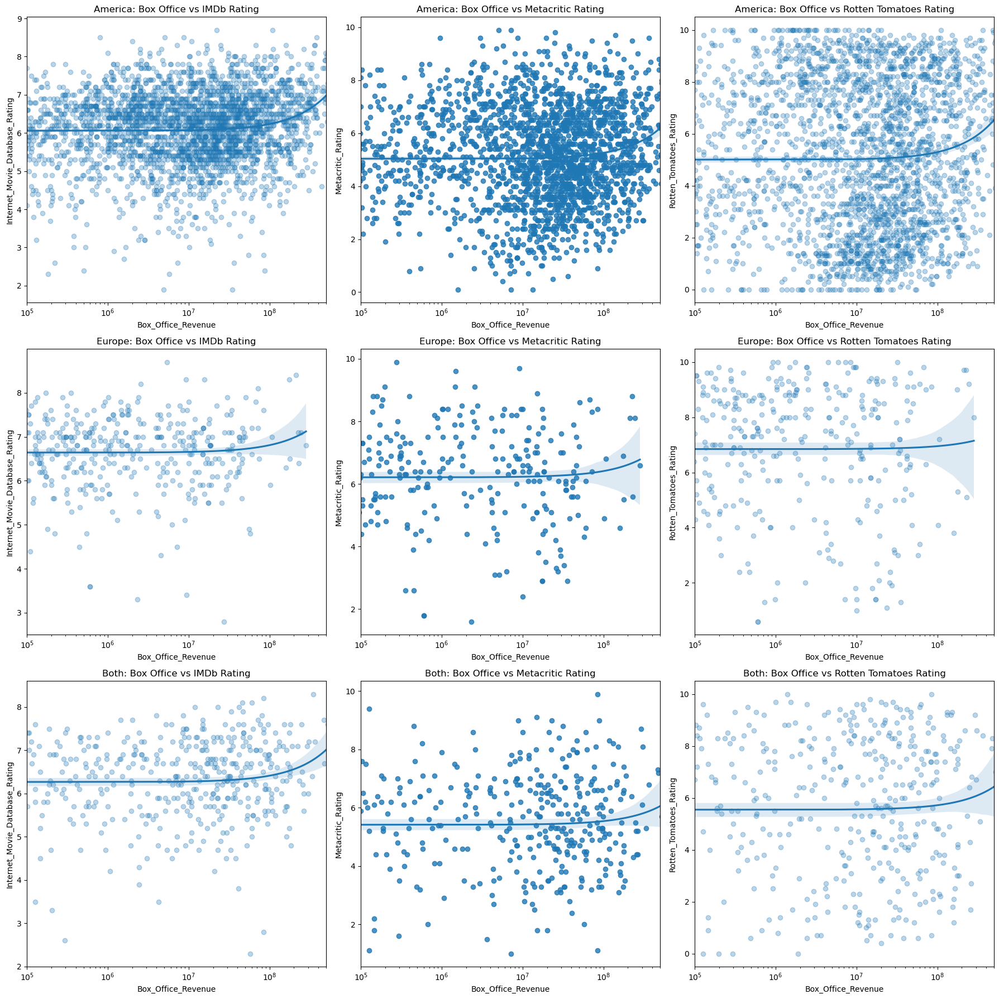

In [29]:
# Filter the data to include only rows with non-null values for Box_Office_Revenue and at least one of the ratings
filtered_data = merged_movie_metadata.dropna(subset=['Box_Office_Revenue', 'Internet_Movie_Database_Rating', 'Rotten_Tomatoes_Rating', 'Metacritic_Rating'], how='all')

# Define the continents to analyze
continents = ['America', 'Europe', 'Both']

# Create a figure with 3 subplots for each continent
fig, axes = plt.subplots(len(continents), 3, figsize=(18, 6 * len(continents)))

# Iterate through each continent and create the regression plots
for i, continent in enumerate(continents):
    continent_data = filtered_data[filtered_data['Continents'].apply(lambda x: continent in x)]
    
    # Create a jointplot for 'Box_Office_Revenue' and 'Internet_Movie_Database_Rating' with a logarithmic scale and transparency
    sns.regplot(
        data=continent_data, x='Box_Office_Revenue', y='Internet_Movie_Database_Rating', ax=axes[i, 0],
        scatter_kws={'alpha':0.3}
    )
    axes[i, 0].set_xscale("log")
    axes[i, 0].set_xlim(1e5, 0.5e9)
    axes[i, 0].set_title(f'{continent}: Box Office vs IMDb Rating')

    # Create an hexbin plot for 'Box_Office_Revenue' and 'Metacritic_Rating'
    sns.regplot(
        data=continent_data, x='Box_Office_Revenue', y='Metacritic_Rating', ax=axes[i, 1]
    )
    axes[i, 1].set_xscale("log")
    axes[i, 1].set_xlim(1e5, 0.5e9)
    axes[i, 1].set_title(f'{continent}: Box Office vs Metacritic Rating')

    # Create a jointplot for 'Box_Office_Revenue' and 'Rotten_Tomatoes_Rating' with a logarithmic scale
    sns.regplot(
        data=continent_data, x='Box_Office_Revenue', y='Rotten_Tomatoes_Rating', ax=axes[i, 2],
        scatter_kws={'alpha':0.3}
    )
    axes[i, 2].set_xscale("log")
    axes[i, 2].set_xlim(1e5, 0.5e9)
    axes[i, 2].set_title(f'{continent}: Box Office vs Rotten Tomatoes Rating')

# Display
plt.tight_layout()
plt.show()

In [30]:
# Filter the data to include only rows with non-null values for Box_Office_Revenue and at least one of the ratings
filtered_data = merged_movie_metadata.dropna(subset=['Box_Office_Revenue', 'Internet_Movie_Database_Rating', 'Rotten_Tomatoes_Rating', 'Metacritic_Rating'], how='all')

# Define the continents to analyze
continents = ['America', 'Europe', 'Both']

# Initialize a dictionary to store the results
correlations = {
    'Continent': [],
    'Score Type': [],
    'Spearman Correlation': [],
    'p-value': [],
    'Significance': []
}

# Calculate Spearman correlation and p-value for each rating and continent
for continent in continents:
    continent_data = filtered_data[filtered_data['Continents'].apply(lambda x: continent in x)]
    for score_type, rating_column in zip(['Internet Movie Database', 'Rotten Tomatoes', 'Metacritic'], ['Internet_Movie_Database_Rating', 'Rotten_Tomatoes_Rating', 'Metacritic_Rating']):
        correlation, p_value = spearmanr(continent_data['Box_Office_Revenue'], continent_data[rating_column], nan_policy='omit')
        correlations['Continent'].append(continent)
        correlations['Score Type'].append(score_type)
        correlations['Spearman Correlation'].append(correlation)
        correlations['p-value'].append(p_value)
        if p_value < 0.05:
            significance = "YES"
        else:
            significance = "NO"
        correlations['Significance'].append(significance)

# Create a DataFrame to store the results
correlation_df = pd.DataFrame(correlations)

# Display the correlation table
display(correlation_df)

,Continent,Score Type,Spearman Correlation,p-value,Significance
0,America,Internet Movie Database,0.136595,3.865323e-15,YES
1,America,Rotten Tomatoes,0.024566,1.936836e-01,NO
2,America,Metacritic,0.066588,1.610712e-03,YES
3,Europe,Internet Movie Database,0.013382,7.635063e-01,NO
4,Europe,Rotten Tomatoes,-0.001806,9.699068e-01,NO
5,Europe,Metacritic,0.048977,3.751512e-01,NO
6,Both,Internet Movie Database,0.122589,9.160448e-03,YES
7,Both,Rotten Tomatoes,0.058265,2.328888e-01,NO
8,Both,Metacritic,0.071128,1.715840e-01,NO


# Nomination_Awards analysis

In [ ]:
print(merged_movie_metadata.describe())
print(merged_movie_metadata.info())
print(merged_movie_metadata.columns)

       Wikipedia_ID  Box_Office_Revenue       Runtime          Year  \
count  1.168100e+04        4.247000e+03  11354.000000  11681.000000   
mean   1.218390e+07        3.822427e+07     82.596094   1976.653968   
std    9.497457e+06        8.746553e+07     34.048925     30.302340   
min    3.217000e+03        2.110000e+02      0.416667   1894.000000   
25%    3.511104e+06        7.211280e+05     79.000000   1951.000000   
50%    1.053643e+07        7.563728e+06     91.000000   1986.000000   
75%    1.931449e+07        3.360311e+07    100.000000   2003.000000   
max    3.715456e+07        1.063172e+09   1003.000000   2025.000000   

         Metascore    imdbRating  Website  totalSeasons         Oscar  \
count  3235.000000  11084.000000      0.0    196.000000  11681.000000   
mean     53.685008      6.144515      NaN      3.306122      0.033730   
std      17.771205      1.056695      NaN      5.289386      0.305025   
min       1.000000      1.300000      NaN      1.000000      0.00000

## Les comédies européennes reçoivent-elles plus de nominations aux récompenses que les comédies américaines ?

In [ ]:
nominations_stats = merged_movie_metadata.groupby('Continents')['Nomination_Awards'].agg(['mean', 'median', 'std', 'count' , 'sum' , 'max' , 'min' , 'var'])
display(nominations_stats)
print("propotion amerique :" , nominations_stats.loc["['America']"]['count'] / nominations_stats['count'].sum())
print("propotion europe :" , nominations_stats.loc["['Europe']"]['count'] / nominations_stats['count'].sum())

# Filter the data for America and Europe
data_america = merged_movie_metadata[merged_movie_metadata['Continents'].apply(lambda x: 'America' in x)]
data_europe = merged_movie_metadata[merged_movie_metadata['Continents'].apply(lambda x: 'Europe' in x)]

,mean,median,std,count,sum,max,min,var
Continents,,,,,,,,
['America'],2.556719,0.0,10.794714,8595,21975,408,0,116.525844
['Both'],6.200935,2.0,13.582077,642,3981,133,0,184.472823
['Europe'],2.384615,0.0,7.810550,2444,5828,232,0,61.004692


propotion amerique : 0.7358102902148789
propotion europe : 0.2092286619296293


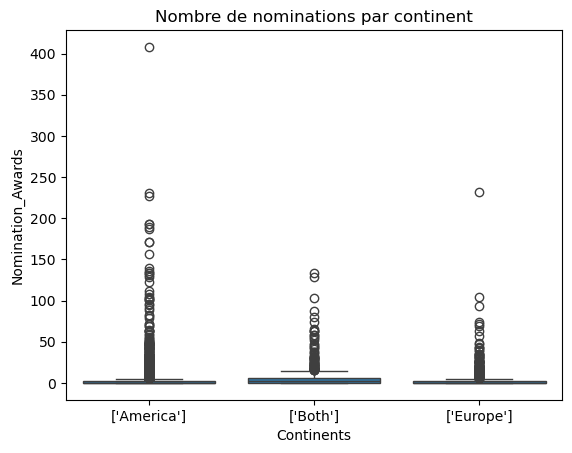

In [ ]:
sns.boxplot(data=merged_movie_metadata, x='Continents', y='Nomination_Awards')
plt.title('Nombre de nominations par continent')
plt.show()


/opt/anaconda3/envs/ada/lib/python3.11/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


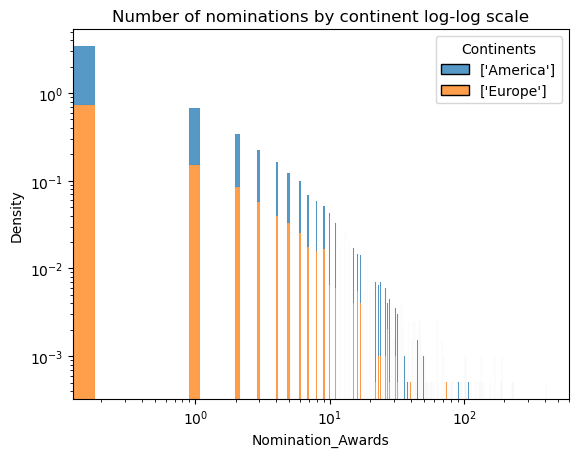

In [ ]:

sns.histplot(data=merged_movie_metadata[merged_movie_metadata['Continents'] != "['Both']"], x='Nomination_Awards', hue='Continents', multiple='stack', stat='density')
plt.title('Number of nominations by continent log-log scale') 
plt.yscale('log')
plt.xscale('log') 
plt.show()


Note: you may need to restart the kernel to use updated packages.
Calculating best minimal value for power law fit


Values less than or equal to 0 in data. Throwing out 0 or negative values


Alpha for American films: 2.44252073539349
Calculating best minimal value for power law fit
xmin progress: 20%

Values less than or equal to 0 in data. Throwing out 0 or negative values


Alpha for European films: 3.0458462787134133


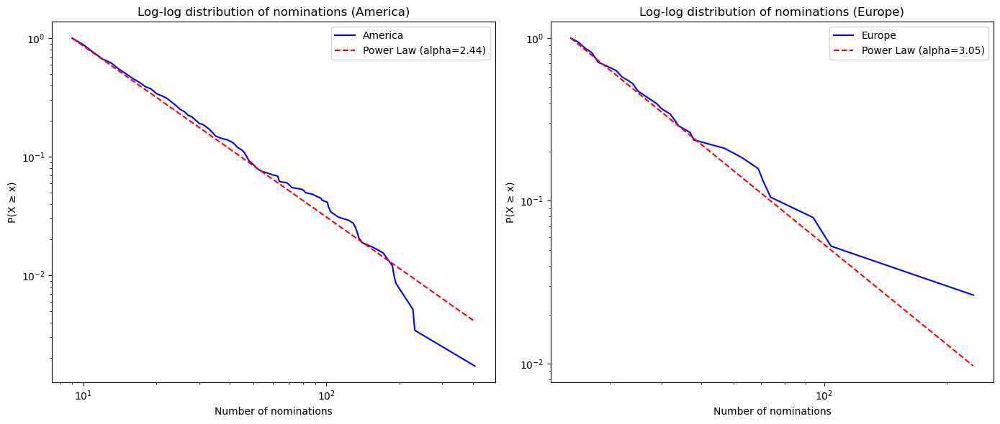

In [ ]:
%pip install powerlaw
import powerlaw
import matplotlib.pyplot as plt

# Extract nomination data for America and Europe
nominations_america = data_america['Nomination_Awards'].dropna()
nominations_europe = data_europe['Nomination_Awards'].dropna()

# Fit the power law distribution to the American nominations data
fit_america = powerlaw.Fit(nominations_america)
alpha_america = fit_america.power_law.alpha
print(f"Alpha for American films: {alpha_america}")

# Fit the power law distribution to the European nominations data
fit_europe = powerlaw.Fit(nominations_europe)
alpha_europe = fit_europe.power_law.alpha
print(f"Alpha for European films: {alpha_europe}")

# Plot the log-log graphs to visualize the fits
fig, ax = plt.subplots(1, 2, figsize=(14, 6))

fit_america.plot_ccdf(ax=ax[0], color='b', label='America')
fit_america.power_law.plot_ccdf(ax=ax[0], color='r', linestyle='--', label=f'Power Law (alpha={alpha_america:.2f})')
ax[0].set_title('Log-log distribution of nominations (America)')
ax[0].set_xlabel('Number of nominations')
ax[0].set_ylabel('P(X ≥ x)')
ax[0].legend()

fit_europe.plot_ccdf(ax=ax[1], color='b', label='Europe')
fit_europe.power_law.plot_ccdf(ax=ax[1], color='r', linestyle='--', label=f'Power Law (alpha={alpha_europe:.2f})')
ax[1].set_title('Log-log distribution of nominations (Europe)')
ax[1].set_xlabel('Number of nominations')
ax[1].set_ylabel('P(X ≥ x)')
ax[1].legend()

plt.tight_layout()
plt.show()


In [ ]:
from scipy.stats import gmean

# Calculate the geometric mean for each continent
geo_mean_america = gmean(data_america['Nomination_Awards'] + 1) - 1  # Adding 1 to avoid zero values
geo_mean_europe = gmean(data_europe['Nomination_Awards'] + 1) - 1

print(f"Geometric mean of nominations for American comedy films: {geo_mean_america:.2f}")
print(f"Geometric mean of nominations for European comedy films: {geo_mean_europe:.2f}")

Geometric mean of nominations for American comedy films: 0.76
Geometric mean of nominations for European comedy films: 0.85


In [ ]:

# Calculate the proportion of American comedy films that received at least one nomination
proportion_america = data_america[data_america['Nomination_Awards'] > 0].shape[0] / data_america.shape[0]

# Calculate the proportion of European comedy films that received at least one nomination
proportion_europe = data_europe[data_europe['Nomination_Awards'] > 0].shape[0] / data_europe.shape[0]

print(f"Proportion of American comedy films with at least one nomination: {proportion_america:.2%}")
print(f"Proportion of European comedy films with at least one nomination: {proportion_europe:.2%}")


Proportion of American comedy films with at least one nomination: 37.74%
Proportion of European comedy films with at least one nomination: 41.16%


En comparant ces proportions, les films comiques européens semblent légèrement plus appréciés (41.16 % ont au moins une nomination) que les films comiques américains (37.74 %). Cependant, cela reflète uniquement une mesure basée sur les nominations et ne tient pas compte d'autres facteurs comme les scores du public ou du box-office. Pour une conclusion plus précise, il faudrait analyser d'autres critères et exclure les éventuelles valeurs aberrantes dans les données.

### Supprimer les valeurs aberrantes

In [ ]:
import plotly.express as px

# Combine the data for America and Europe
combined_data = pd.concat([data_america.assign(Continent='America'), data_europe.assign(Continent='Europe')])

# Create a violin plot using Plotly
fig = px.violin(combined_data, x='Continent', y='Nomination_Awards', color='Continent', 
                box=True, points='all', hover_data=combined_data.columns,
                title='Nomination distribution by continent',
                labels={'Nomination_Awards': 'Nombre de nominations', 'Continent': 'Continent'})

# Update layout for better aesthetics
fig.update_layout(
    template='plotly_dark',
    title_font_size=20,
    legend_title_text='Continent',
    xaxis_title='Continent',
    yaxis_title='Number of nominations',
    font=dict(size=12)
)

# Show the plot
fig.show()

# Save the plot as an HTML file
fig.write_html("nomination_distribution_by_continent.html")


In [ ]:
import plotly.graph_objects as go

# Perform the Mann-Whitney U test
u_statistic, p_value = mannwhitneyu(data_america_cleaned['Nomination_Awards'], data_europe_cleaned['Nomination_Awards'], alternative='two-sided')

print(f"Mann-Whitney U statistic: {u_statistic}")
print(f"P-value: {p_value}")

# Calculate the mean and confidence interval for each continent
mean_nomination_america = new_nominations_stats_america['mean']
mean_nomination_europe = new_nominations_stats_europe['mean']
std_nomination_america = new_nominations_stats_america['std']
std_nomination_europe = new_nominations_stats_europe['std']
count_america = new_nominations_stats_america['count']
count_europe = new_nominations_stats_europe['count']

# Calculate the 95% confidence interval
ci_america = 1.96 * (std_nomination_america / np.sqrt(count_america))
ci_europe = 1.96 * (std_nomination_europe / np.sqrt(count_europe))

# Create an interactive bar plot
fig = go.Figure()

fig.add_trace(go.Bar(
    x=['America', 'Europe'],
    y=[mean_nomination_america, mean_nomination_europe],
    error_y=dict(type='data', array=[ci_america, ci_europe], visible=True),
    marker_color=['blue', 'orange']
))

# Add labels and title
fig.update_layout(
    title='Nomination Mean by Continent',
    yaxis_title='Mean nominations',
    xaxis_title='Continent'
)


# Display the plot
fig.show()

# Save the plot as an HTML file
fig.write_html("nomination_mean_by_continent.html")

Mann-Whitney U statistic: 7991598.5
P-value: 0.001672037463779343


Différence statistiquement significative entre les distributions de nominations pour les comédies américaines et européennes. Les comédies européennes reçoivent en moyenne plus de nominations que les comédies américaines.

### Facteurs influençant les nominations

In [ ]:
from scipy.stats import fisher_exact


ratings = ['imdbRating', 'Rotten_Tomatoes_Rating', 'Metacritic_Rating']


for rating in ratings:
    correlation, p_value = spearmanr(data_america['Nomination_Awards'], data_america[rating], nan_policy='omit')
    print(f"Amérique : Corrélation entre les nominations et {rating}: {correlation:.2f}, p-value: {p_value:4f}")
print("------------------------------------")
for rating in ratings:
    correlation, p_value = spearmanr(data_europe['Nomination_Awards'], data_europe[rating], nan_policy='omit')
    print(f"Europe : Corrélation entre les nominations et {rating}: {correlation:.2f}, p-value: {p_value:4f}")



    # Function to perform Fisher-Z transformation
    def fisher_z(correlation):
        return np.arctanh(correlation)

    # Function to perform Fisher's Z-test
    def fisher_z_test(corr1, n1, corr2, n2):
        z1 = fisher_z(corr1)
        z2 = fisher_z(corr2)
        se_diff = np.sqrt(1/(n1-3) + 1/(n2-3))
        z = (z1 - z2) / se_diff
        p_value = 2 * (1 - stats.norm.cdf(abs(z)))
        return z, p_value

    # Number of samples in each group
    n_america = len(data_america_cleaned)
    n_europe = len(data_europe_cleaned)

    # Perform Fisher's Z-test for each rating
    for rating in ratings:
        corr_america, _ = spearmanr(data_america_cleaned['Nomination_Awards'], data_america_cleaned[rating], nan_policy='omit')
        corr_europe, _ = spearmanr(data_europe_cleaned['Nomination_Awards'], data_europe_cleaned[rating], nan_policy='omit')
        z, p_value = fisher_z_test(corr_america, n_america, corr_europe, n_europe)
        print(f"Test de Fisher-Z pour {rating}: Z = {z:.2f}, p-value = {p_value:4f}")


Amérique : Corrélation entre les nominations et imdbRating: 0.21, p-value: 0.000000
Amérique : Corrélation entre les nominations et Rotten_Tomatoes_Rating: 0.31, p-value: 0.000000
Amérique : Corrélation entre les nominations et Metacritic_Rating: 0.41, p-value: 0.000000
------------------------------------
Europe : Corrélation entre les nominations et imdbRating: 0.42, p-value: 0.000000
Test de Fisher-Z pour imdbRating: Z = -11.04, p-value = 0.000000
Test de Fisher-Z pour Rotten_Tomatoes_Rating: Z = -4.59, p-value = 0.000004
Test de Fisher-Z pour Metacritic_Rating: Z = -6.30, p-value = 0.000000
Europe : Corrélation entre les nominations et Rotten_Tomatoes_Rating: 0.29, p-value: 0.000000
Test de Fisher-Z pour imdbRating: Z = -11.04, p-value = 0.000000
Test de Fisher-Z pour Rotten_Tomatoes_Rating: Z = -4.59, p-value = 0.000004
Test de Fisher-Z pour Metacritic_Rating: Z = -6.30, p-value = 0.000000
Europe : Corrélation entre les nominations et Metacritic_Rating: 0.45, p-value: 0.000000
Tes


Amérique vs Europe :
Les films européens semblent bénéficier davantage des avis des spectateurs (imdbRating : 0.42) que les films américains (0.21).
Les films américains dépendent davantage des Rotten_Tomatoes_Rating (0.31) que les films européens (0.29).
Pour les deux continents, Metacritic_Rating est l'indicateur le plus fortement corrélé aux nominations.
Conclusion partielle :

Les critiques professionnelles (Metacritic_Rating) sont un facteur clé pour les nominations sur les deux continents, mais les spectateurs (via imdbRating) influencent davantage les films européens

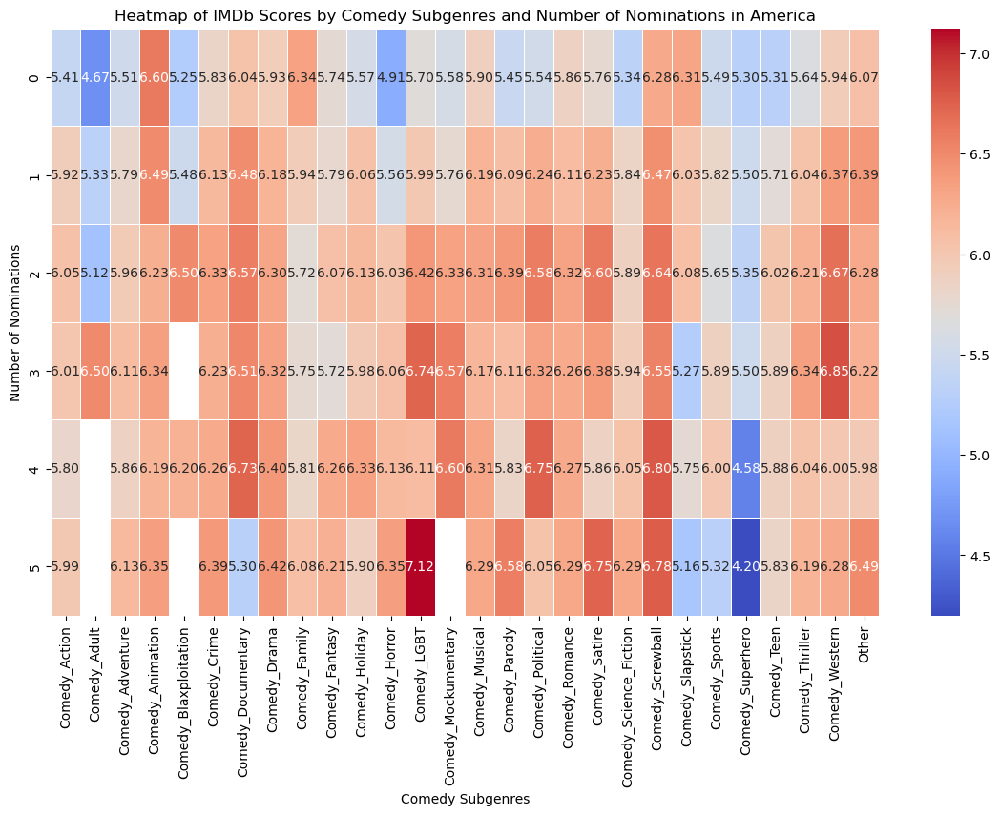

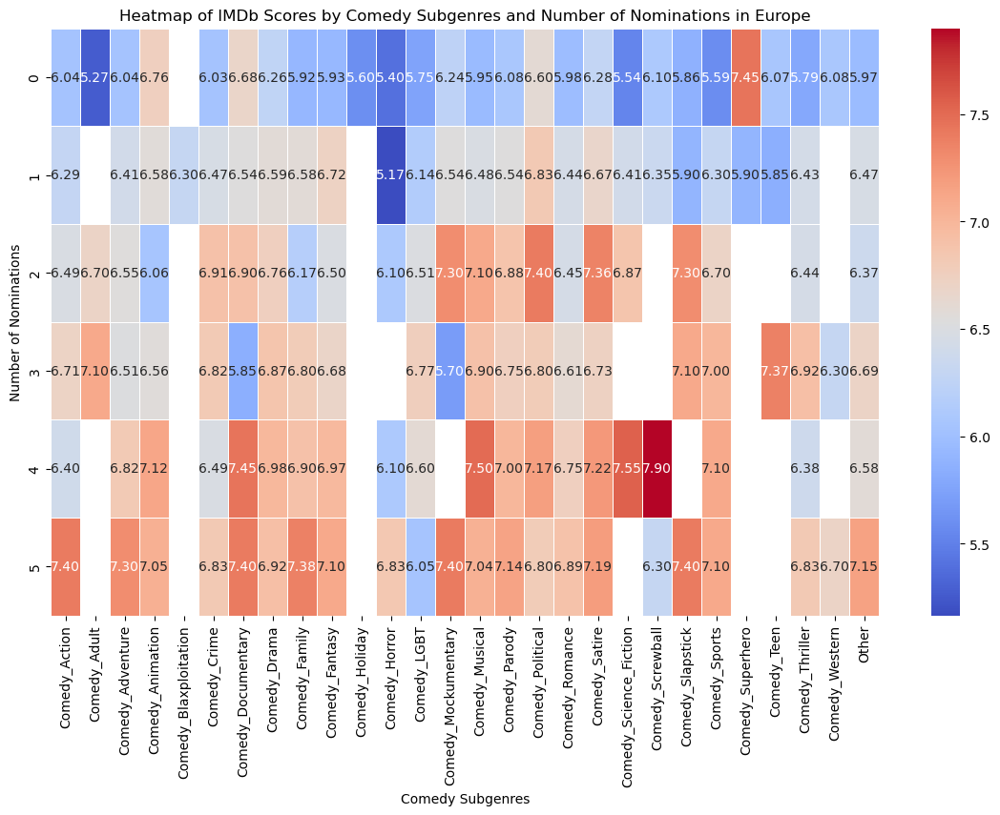

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Prepare the data for the heatmap for each continent
for continent, data in zip(['America', 'Europe'], [data_america_cleaned, data_europe_cleaned]):
    heatmap_data = data.explode('comedy_genres').pivot_table(
        index='Nomination_Awards', 
        columns='comedy_genres', 
        values='Internet_Movie_Database_Rating', 
        aggfunc='mean'
    )
    
    plt.figure(figsize=(14, 8))
    sns.heatmap(heatmap_data, cmap='coolwarm', annot=True, fmt=".2f", linewidths=.5)

    # Add a title and labels
    plt.title(f'Heatmap of IMDb Scores by Comedy Subgenres and Number of Nominations in {continent}')
    plt.xlabel('Comedy Subgenres')
    plt.ylabel('Number of Nominations')

    # Display the heatmap
    plt.show()


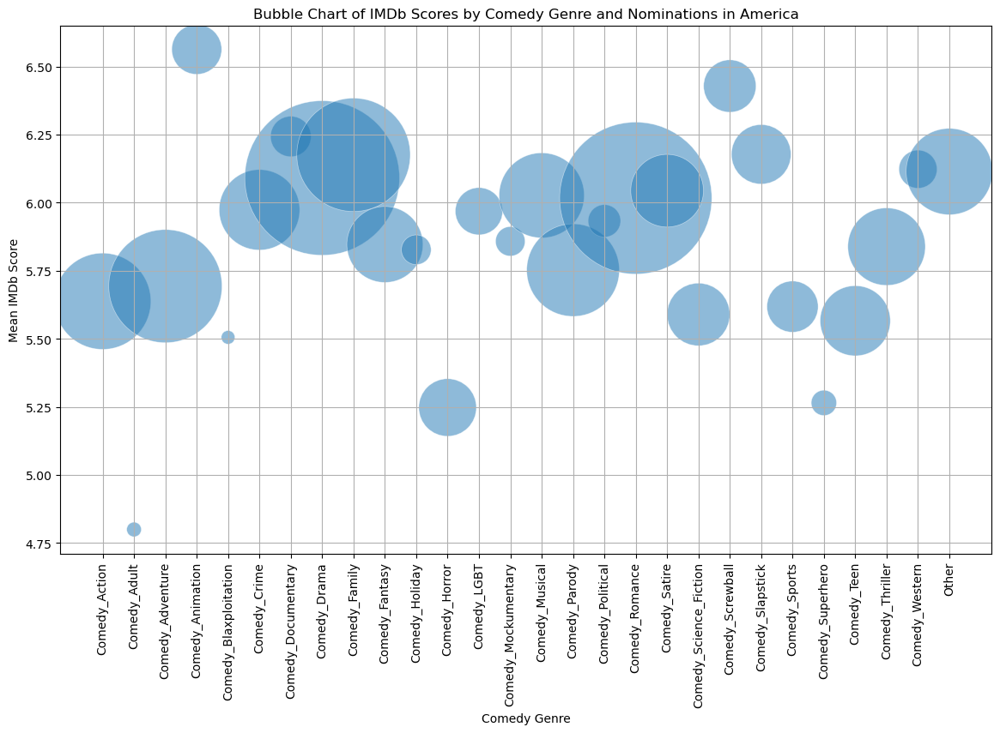

In [ ]:
import mplcursors
import matplotlib.pyplot as plt

# Select the continent data you want to visualize
continent = 'America'  # Change to 'Europe' if needed
data_cleaned = {
    'America': data_america_cleaned,
    'Europe': data_europe_cleaned
}
continent_data = data_cleaned[continent]

# Group by comedy genres and calculate the mean IMDb score and sum of nominations
grouped_data = continent_data.explode('comedy_genres').groupby('comedy_genres').agg({
    'Internet_Movie_Database_Rating': 'mean',
    'Nomination_Awards': 'sum'
}).reset_index()

# Plot the bubble chart
plt.figure(figsize=(14, 8))
bubble = plt.scatter(
    x=grouped_data['comedy_genres'],
    y=grouped_data['Internet_Movie_Database_Rating'],
    s=grouped_data['Nomination_Awards'] * 10,  # Adjust the size multiplier as needed
    alpha=0.5,
    edgecolors='w',
    linewidth=0.5
)

# Add labels and title
plt.xlabel('Comedy Genre')
plt.ylabel('Mean IMDb Score')
plt.title(f'Bubble Chart of IMDb Scores by Comedy Genre and Nominations in {continent}')
plt.xticks(rotation=90)
plt.grid(True)

# Add interactive tooltips
cursor = mplcursors.cursor(bubble, hover=True)
cursor.connect("add", lambda sel: sel.annotation.set_text(
    f"Genre: {grouped_data['comedy_genres'][sel.index]}\n"
    f"IMDb Score: {grouped_data['Internet_Movie_Database_Rating'][sel.index]:.2f}\n"
    f"Nominations: {grouped_data['Nomination_Awards'][sel.index]}"
))

plt.show()



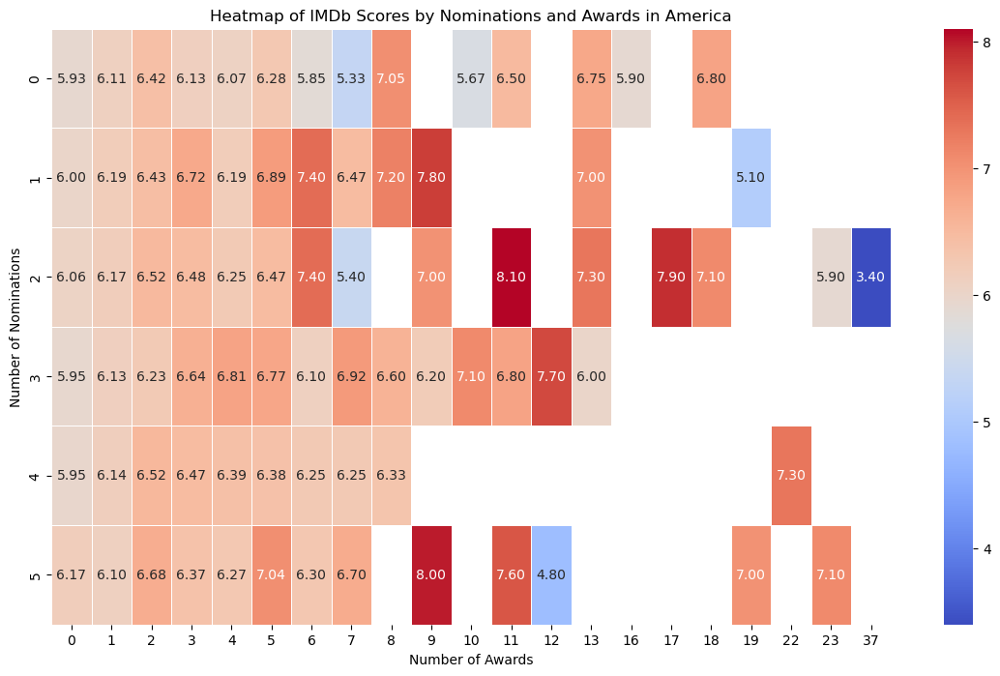

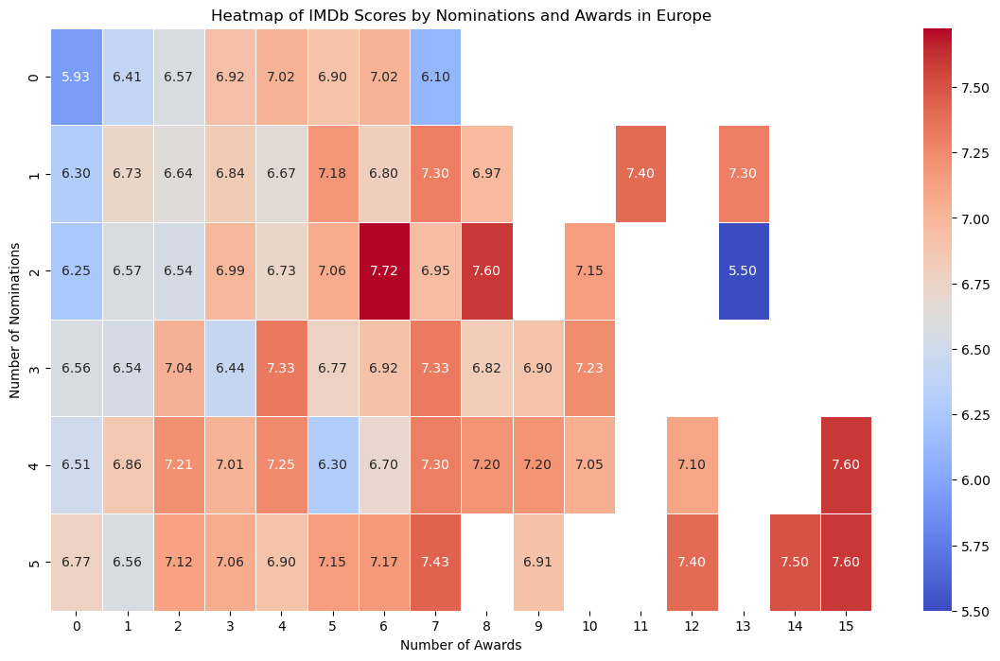

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Utiliser les données nettoyées pour chaque continent
data_cleaned = {
    'America': data_america_cleaned,
    'Europe': data_europe_cleaned
}

for continent, continent_data in data_cleaned.items():
    # Créer un pivot table pour les données
    heatmap_data = continent_data.pivot_table(
        index='Nomination_Awards', 
        columns='Win_Awards', 
        values='Internet_Movie_Database_Rating', 
        aggfunc='mean'
    )

    # Créer la heatmap
    plt.figure(figsize=(14, 8))
    sns.heatmap(heatmap_data, cmap='coolwarm', annot=True, fmt=".2f", linewidths=.5)

    # Ajouter un titre et des labels
    plt.title(f'Heatmap of IMDb Scores by Nominations and Awards in {continent}')
    plt.xlabel('Number of Awards')
    plt.ylabel('Number of Nominations')

    # Afficher la heatmap
    plt.show()

Creation d'une novelle colomns pour data_cleaned_europe et amerique : Succès critique = (0.3 * IMDb normalisé) + (0.3 * Metacritic normalisé ) + (0.2 * Nominations normalisé ) + (0.2 * Award normalisé)

In [ ]:
# Normalize the columns
def normalize_column(column):
    return (column - column.min()) / (column.max() - column.min())

# Apply normalization and calculate 'Succès critique' for each continent
data_cleaned = {
    'America': data_america_cleaned,
    'Europe': data_europe_cleaned
}

for continent in data_cleaned.keys():
    data_cleaned[continent]['Internet_Movie_Database_Rating_Normalized'] = normalize_column(data_cleaned[continent]['Internet_Movie_Database_Rating'])
    data_cleaned[continent]['Nomination_Awards_Normalized'] = normalize_column(data_cleaned[continent]['Nomination_Awards'])
    # Fill NaN values in 'Win_Awards' with 0 before normalizing
    data_cleaned[continent]['Win_Awards'] = data_cleaned[continent]['Win_Awards'].fillna(0)
    data_cleaned[continent]['Win_Awards_Normalized'] = normalize_column(data_cleaned[continent]['Win_Awards'])
    
    data_cleaned[continent]['Succès_critique'] = (
        0.4 * data_cleaned[continent]['Internet_Movie_Database_Rating_Normalized'] +
        0.3 * data_cleaned[continent]['Nomination_Awards_Normalized'] +
        0.3 * data_cleaned[continent]['Win_Awards_Normalized']
    )

# Separate the data for Europe and America
data_cleaned_europe = data_cleaned['Europe']
data_cleaned_america = data_cleaned['America']

nan_count_europe = data_cleaned_europe['Succès_critique'].isna().sum()
nan_count_america = data_cleaned_america['Succès_critique'].isna().sum()

print(f"Nombre de NaN dans 'Succès_critique' pour l'Europe: {nan_count_europe}")
print(f"Nombre de NaN dans 'Succès_critique' pour l'Amérique: {nan_count_america}")

# Drop rows with NaN values in the 'Succès_critique' column for both continents
data_cleaned_europe1 = data_cleaned_europe.dropna(subset=['Succès_critique'])
data_cleaned_america1 = data_cleaned_america.dropna(subset=['Succès_critique'])

# Display the first few rows to verify the changes
display(data_cleaned_europe1[['Movie_Name', 'Succès_critique']].head() , data_cleaned_europe1.shape)
display(data_cleaned_america1[['Movie_Name', 'Succès_critique']].head(), data_cleaned_america1.shape)



Nombre de NaN dans 'Succès_critique' pour l'Europe: 147
Nombre de NaN dans 'Succès_critique' pour l'Amérique: 445


/var/folders/w1/f3785wtj77166md17d9fj02w0000gn/T/ipykernel_2303/433989443.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_cleaned[continent]['Internet_Movie_Database_Rating_Normalized'] = normalize_column(data_cleaned[continent]['Internet_Movie_Database_Rating'])
/var/folders/w1/f3785wtj77166md17d9fj02w0000gn/T/ipykernel_2303/433989443.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_cleaned[continent]['Nomination_Awards_Normalized'] = normalize_column(data_cleaned[continent]['Nomination_

,Movie_Name,Succès_critique
19,"Black Cat, White Cat",0.729333
31,Taxi,0.616000
34,Der Mann im Pyjama,0.265333
38,"The Prophet, the Gold and the Transylvanians",0.282667
47,9 Dead Gay Guys,0.253333


(2013, 41)

,Movie_Name,Succès_critique
0,The Gangsters,0.224390
4,White on Rice,0.258471
5,Archie: To Riverdale and Back Again,0.195122
8,Follow the Crowd,0.224390
10,Loverboy,0.234146


(7232, 41)

In [ ]:
# Calculer les moyennes des indices pour chaque combinaison de sous-genre et de continent
def calculate_means(data):
    # Explode the comedy_genres column to ensure each genre is in a separate row
    data_exploded = data.explode('comedy_genres')
    return data_exploded.groupby(['comedy_genres', 'Continents']).agg({
        'Succès_critique': 'mean',
        'Nomination_Awards': 'mean',
        'Win_Awards': 'mean'
    }).reset_index()

# Calculer les moyennes pour les données américaines et européennes
means_america = calculate_means(data_cleaned_america1)
means_europe = calculate_means(data_cleaned_europe1)

# Identifier les sous-genres performants
def identify_top_subgenres(means_data, region):
    top_subgenres = means_data.sort_values(by='Succès_critique', ascending=False).head(10)
    print(f"Top subgenres in {region}:")
    display(top_subgenres)

# Afficher les sous-genres performants pour chaque région
identify_top_subgenres(means_america, 'America')
identify_top_subgenres(means_europe, 'Europe')

# Comparer les résultats entre les régions
comparison = pd.merge(means_america, means_europe, on='comedy_genres', suffixes=('_America', '_Europe'))
comparison = comparison[['comedy_genres', 'Succès_critique_America', 'Succès_critique_Europe', 'Nomination_Awards_America', 'Nomination_Awards_Europe', 'Win_Awards_America', 'Win_Awards_Europe']]
comparison['Difference_Succès_critique'] = comparison['Succès_critique_America'] - comparison['Succès_critique_Europe']
comparison['Difference_Nomination_Awards'] = comparison['Nomination_Awards_America'] - comparison['Nomination_Awards_Europe']
comparison['Difference_Win_Awards'] = comparison['Win_Awards_America'] - comparison['Win_Awards_Europe']

# Afficher la comparaison
print("Comparison of top subgenres between America and Europe:")
display(comparison.sort_values(by='Difference_Succès_critique', ascending=False).head(10))

Top subgenres in America:


,comedy_genres,Continents,Succès_critique,Nomination_Awards,Win_Awards
20,Comedy_Screwball,['America'],0.314750,1.000000,0.564767
10,Comedy_Holiday,['America'],0.309626,1.409091,0.522727
12,Comedy_LGBT,['America'],0.302075,0.981250,1.906250
7,Comedy_Drama,['America'],0.301391,1.018822,0.809350
6,Comedy_Documentary,['America'],0.299405,0.858209,0.835821
18,Comedy_Satire,['America'],0.299167,1.027933,0.748603
9,Comedy_Fantasy,['America'],0.297498,1.183140,0.581395
17,Comedy_Romance,['America'],0.293648,0.973070,0.637941
16,Comedy_Political,['America'],0.290535,0.960000,0.853333
8,Comedy_Family,['America'],0.287096,0.774359,0.343590


Top subgenres in Europe:


,comedy_genres,Continents,Succès_critique,Nomination_Awards,Win_Awards
16,Comedy_Political,['Europe'],0.388817,1.419355,2.709677
7,Comedy_Drama,['Europe'],0.345126,1.333333,1.671692
3,Comedy_Animation,['Europe'],0.342388,1.279070,1.325581
12,Comedy_LGBT,['Europe'],0.334815,1.425926,1.870370
18,Comedy_Satire,['Europe'],0.333547,1.179245,1.358491
6,Comedy_Documentary,['Europe'],0.326575,1.103448,1.000000
8,Comedy_Family,['Europe'],0.318301,1.294118,1.156863
13,Comedy_Mockumentary,['Europe'],0.313704,0.944444,1.444444
17,Comedy_Romance,['Europe'],0.307128,1.129032,1.152493
15,Comedy_Parody,['Europe'],0.305372,1.011628,1.052326


Comparison of top subgenres between America and Europe:


,comedy_genres,Succès_critique_America,Succès_critique_Europe,Nomination_Awards_America,Nomination_Awards_Europe,Win_Awards_America,Win_Awards_Europe,Difference_Succès_critique,Difference_Nomination_Awards,Difference_Win_Awards
10,Comedy_Holiday,0.309626,0.181333,1.409091,0.000000,0.522727,0.000000,0.128293,1.409091,0.522727
26,Comedy_Western,0.278116,0.240444,0.675497,0.380952,0.284768,0.428571,0.037671,0.294544,-0.143803
20,Comedy_Screwball,0.314750,0.287111,1.000000,0.888889,0.564767,0.888889,0.027639,0.111111,-0.324122
19,Comedy_Science_Fiction,0.272708,0.253625,0.985714,0.687500,0.532143,0.468750,0.019083,0.298214,0.063393
14,Comedy_Musical,0.282394,0.268814,0.807937,0.694737,0.411111,0.684211,0.013580,0.113200,-0.273099
21,Comedy_Slapstick,0.275310,0.261905,0.584507,0.657143,0.284038,0.685714,0.013405,-0.072636,-0.401677
27,Other,0.257523,0.245862,0.339510,0.465909,0.283918,0.508838,0.011661,-0.126399,-0.224920
11,Comedy_Horror,0.244051,0.234133,0.792517,0.711111,0.482993,0.577778,0.009917,0.081406,-0.094785
2,Comedy_Adventure,0.280209,0.277626,1.042775,0.853659,0.409249,0.536585,0.002583,0.189116,-0.127337
9,Comedy_Fantasy,0.297498,0.295048,1.183140,1.000000,0.581395,0.857143,0.002450,0.183140,-0.275748


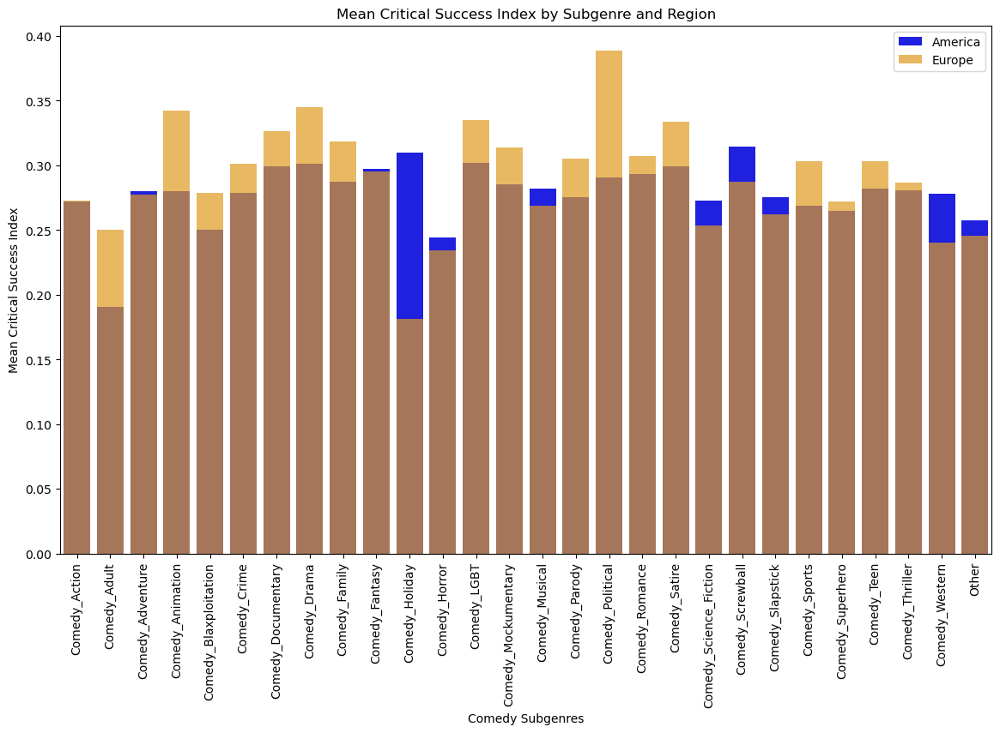

ValueError: Could not interpret value `Succès_critique` for `y`. An entry with this name does not appear in `data`.

<Figure size 1400x800 with 0 Axes>

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Ensure 'comparison' and 'combined_data' are defined
# Assuming 'comparison' and 'combined_data' are already defined in previous cells

# 5.1 Graphiques comparatifs

# Bar chart comparatif pour les indices moyens par sous-genre et par région
plt.figure(figsize=(14, 8))
sns.barplot(data=comparison, x='comedy_genres', y='Succès_critique_America', color='blue', label='America')
sns.barplot(data=comparison, x='comedy_genres', y='Succès_critique_Europe', color='orange', label='Europe', alpha=0.7)
plt.xticks(rotation=90)
plt.xlabel('Comedy Subgenres')
plt.ylabel('Mean Critical Success Index')
plt.title('Mean Critical Success Index by Subgenre and Region')
plt.legend()
plt.show()

# Box plot pour visualiser la distribution des indices
plt.figure(figsize=(14, 8))
sns.boxplot(data=combined_data, x='comedy_genres', y='Succès_critique', hue='Continents')
plt.xticks(rotation=90)
plt.xlabel('Comedy Subgenres')
plt.ylabel('Critical Success Index')
plt.title('Distribution of Critical Success Index by Subgenre and Region')
plt.legend()
plt.show()

# Stacked bar charts pour montrer la contribution des métriques à l’indice total
metrics = ['Internet_Movie_Database_Rating_Normalized', 'Metacritic_Rating_Normalized', 'Nomination_Awards_Normalized', 'Win_Awards_Normalized']
comparison['Total'] = comparison[metrics].sum(axis=1)

fig, ax = plt.subplots(figsize=(14, 8))
bottom = np.zeros(len(comparison))
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
for metric, color in zip(metrics, colors):
    ax.bar(comparison['comedy_genres'], comparison[metric], bottom=bottom, label=metric, color=color)
    bottom += comparison[metric]
ax.set_xlabel('Comedy Subgenres')
ax.set_ylabel('Contribution to Total Index')
ax.set_title('Contribution of Metrics to Total Index by Subgenre and Region')
ax.legend()
plt.xticks(rotation=90)
plt.show()

# 5.2 Cartes de chaleur (Heatmaps)

# Heatmap des corrélations entre les métriques
correlation_matrix = combined_data[metrics].corr()
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
plt.title('Correlations between Critical Metrics')
plt.show()

# Heatmap pour visualiser les indices moyens par sous-genre et région
pivot_table = combined_data.pivot_table(index='comedy_genres', columns='Continents', values='Succès_critique', aggfunc='mean')
plt.figure(figsize=(14, 8))
sns.heatmap(pivot_table, annot=True, cmap='YlGnBu')
plt.title('Mean Critical Success Index by Subgenre and Region')
plt.xlabel('Region')
plt.ylabel('Comedy Subgenres')
plt.show()

## Facteurs influençant les nominations

In [ ]:
display(merged_movie_metadata["comedy_genres"].value_counts())
display(merged_movie_metadata["Rated"].value_counts())

comedy_genres
[Other]                                                                                                      2896
[Comedy_Drama]                                                                                                848
[Comedy_Romance]                                                                                              714
[Comedy_Drama, Comedy_Romance]                                                                                669
[Comedy_Family]                                                                                               272
                                                                                                             ... 
[Comedy_Thriller, Comedy_Adventure, Comedy_Drama, Comedy_Action, Comedy_Animation]                              1
[Comedy_Science_Fiction, Comedy_Family, Comedy_Parody, Comedy_Adventure, Comedy_Satire, Comedy_Animation]       1
[Comedy_Slapstick, Comedy_Family, Comedy_Adventure, Comedy_Holiday, Comedy

Rated
Not Rated                              4677
Recommended Parental Agreement (AP)    2475
16+                                    2261
All Audiences (TP)                     2160
13+                                      86
18+                                      22
Name: count, dtype: int64

### Gérer les valeurs manquante en les supprimants

In [ ]:
# Vérifier les valeurs manquantes
merged_movie_metadata[["Runtime", "imdbRating", "Rotten_Tomatoes_Rating", "Metacritic_Rating", "Rated" ,"Nomination_Awards" , "comedy_genres"]].isnull().sum()

Runtime                    327
imdbRating                 597
Rotten_Tomatoes_Rating    6920
Metacritic_Rating         8446
Rated                        0
Nomination_Awards            0
comedy_genres                0
dtype: int64

In [ ]:
# Supprimer les lignes avec des valeurs manquantes dans les variables clés
data = merged_movie_metadata.dropna(subset=["Runtime", "imdbRating","Rated" ,"Nomination_Awards" , "comedy_genres" , 'Rotten_Tomatoes_Rating', 'Metacritic_Rating'])
data.shape

(3121, 36)

### Gerer les variables catégorielles et les mettres en one hot encoding

In [ ]:
# Encoder 'Continents'
colomns_continent = pd.get_dummies(data['Continents'], prefix='Continent')
display(colomns_continent.head())
# Encoder 'Rated'
colomns_rated = pd.get_dummies(data['Rated'], prefix='Rated')
display(colomns_rated.head())

# comedy_genres
# Create binary columns for each unique comedy subgenre
unique_genres = set([genre for sublist in data['comedy_genres'] for genre in sublist])
colomns_genres = pd.DataFrame({genre: data['comedy_genres'].apply(lambda x: genre in x) for genre in unique_genres})
display(colomns_genres.head())



,Continent_['America'],Continent_['Both'],Continent_['Europe']
3,True,False,False
4,True,False,False
9,True,False,False
10,True,False,False
16,True,False,False


,Rated_13+,Rated_16+,Rated_18+,Rated_All Audiences (TP),Rated_Not Rated,Rated_Recommended Parental Agreement (AP)
3,False,False,False,True,False,False
4,False,False,False,False,False,True
9,False,True,False,False,False,False
10,False,False,False,False,False,True
16,False,True,False,False,False,False


,Comedy_Horror,Comedy_Crime,Comedy_Superhero,Comedy_Mockumentary,Comedy_Science_Fiction,Comedy_Teen,Comedy_Musical,Comedy_Romance,Comedy_Family,Comedy_Thriller,...,Comedy_Holiday,Comedy_Sports,Comedy_Drama,Comedy_Fantasy,Comedy_Western,Comedy_Screwball,Comedy_Adult,Comedy_Parody,Comedy_Blaxploitation,Comedy_LGBT
3,False,False,False,False,False,False,True,False,True,False,...,False,False,True,True,False,False,False,False,False,False
4,False,False,False,False,False,False,False,True,False,False,...,False,False,False,False,False,False,False,False,False,False
9,False,False,False,False,False,False,False,False,True,False,...,False,True,True,False,False,False,False,False,False,False
10,False,False,False,False,False,False,False,True,False,False,...,False,False,False,False,False,False,False,False,False,False
16,False,True,False,False,False,False,False,False,False,True,...,False,False,False,False,False,False,False,False,False,False


In [ ]:
# Concatenate the columns to the data DataFrame
data = pd.concat([data, colomns_continent, colomns_rated, colomns_genres], axis=1)
display(data.head())
data[["Box_Office_Revenue" ,"Runtime" , "imdbRating", "Rotten_Tomatoes_Rating", "Metacritic_Rating"] + colomns_continent.columns.tolist() + colomns_rated.columns.tolist() + colomns_genres.columns.tolist()]
data.shape

,Wikipedia_ID,Movie_Name,Release_Date,Box_Office_Revenue,Runtime,Languages,Countries,Genres,Continents combi,Year,...,Comedy_Holiday,Comedy_Sports,Comedy_Drama,Comedy_Fantasy,Comedy_Western,Comedy_Screwball,Comedy_Adult,Comedy_Parody,Comedy_Blaxploitation,Comedy_LGBT
3,77856,Mary Poppins,1964-08-27,102272727.0,139.0,['English Language'],['United States of America'],"[""Children's/Family"", 'Musical', 'Fantasy', 'C...",['America'],1964,...,False,False,True,True,False,False,False,False,False,False
4,21926710,White on Rice,2009,69171.0,82.0,['Unknown'],['United States of America'],"['Romantic comedy', 'Romance Film', 'Comedy', ...",['America'],2009,...,False,False,False,False,False,False,False,False,False,False
9,12008535,Rudo y Cursi,2008,11091868.0,103.0,['Spanish Language'],"['Mexico', 'United States of America']","['Sports', 'Drama', 'Family Drama', 'Comedy-dr...",['America'],2008,...,False,True,True,False,False,False,False,False,False,False
10,12053509,Loverboy,1989-04-28,3960327.0,98.0,['English Language'],['United States of America'],"['Romantic comedy', 'Romance Film', 'Comedy']",['America'],1989,...,False,False,False,False,False,False,False,False,False,False
16,3550323,Things to Do in Denver When You're Dead,1995-10,529677.0,115.0,['English Language'],['United States of America'],"['Thriller', 'Crime Fiction', 'Crime Comedy', ...",['America'],1995,...,False,False,False,False,False,False,False,False,False,False


(3121, 73)

In [ ]:
# Rename the column 'Continent_['America']' to 'Continent_America'
data.rename(columns={"Continent_['America']": "Continent_America"}, inplace=True)
# Rename the columns 'Continent_['Both']' and 'Continent_['Europe']'
data.rename(columns={"Continent_['Both']": "Continent_Both", "Continent_['Europe']": "Continent_Europe"}, inplace=True)

# Séparer les données pour le continent 'America'
data_america = data[data["Continent_America"] == True]

# Séparer les données pour le continent 'Europe'
data_europe = data[data["Continent_Europe"] == True]

In [ ]:
colomns_model = ["Runtime", "imdbRating","Nomination_Awards" ,'Rotten_Tomatoes_Rating', 'Metacritic_Rating' ]
# Afficher les premières lignes de chaque DataFrame pour vérification
data_america = data_america[colomns_model]
data_europe = data_europe[colomns_model]


In [ ]:
display(data_america.columns ,data_america.shape )
display(data_europe.columns, data_europe.shape)

Index(['Runtime', 'imdbRating', 'Nomination_Awards', 'Rotten_Tomatoes_Rating',
       'Metacritic_Rating'],
      dtype='object')

(2368, 5)

Index(['Runtime', 'imdbRating', 'Nomination_Awards', 'Rotten_Tomatoes_Rating',
       'Metacritic_Rating'],
      dtype='object')

(376, 5)

### Division des données en ensembles d'entraînement et de test

In [ ]:
from sklearn.model_selection import train_test_split

# Define the target variable Y and the feature matrix X
Y_america = data_america["Nomination_Awards"]
X_america= data_america.drop(columns=["Nomination_Awards"])

Y_europe = data_europe["Nomination_Awards"]
X_europe= data_europe.drop(columns=["Nomination_Awards"])

# Diviser les données
X_train_america, X_test_america, y_train_america, y_test_america = train_test_split(X_america, Y_america, test_size=0.2, random_state=42)
X_train_europe, X_test_europe, y_train_europe, y_test_europe = train_test_split(X_europe, Y_europe, test_size=0.2, random_state=42)


### Étant donné que les revenus du box-office sont asymétriques, nous allons appliquer une transformation logarithmique.

In [ ]:
from sklearn.linear_model import Ridge
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler


# Standardisation
scaler = StandardScaler()
X_train_scaled_america = scaler.fit_transform(X_train_america)  # Calcul de la moyenne et std sur train, puis transformation
X_test_scaled_america = scaler.transform(X_test_america)       # Transformation avec les stats de train
X_train_scaled_europe = scaler.fit_transform(X_train_europe)  # Calcul de la moyenne et std sur train, puis transformation
X_test_scaled_europe = scaler.transform(X_test_europe)       # Transformation avec les stats de train


from sklearn.linear_model import Ridge

# Créer les modèles régularisés
regressor_america = Ridge(alpha=1.0)  # Tu peux ajuster alpha pour plus ou moins de régularisation
regressor_europe = Ridge(alpha=1.0)

# Ajuster les modèles
regressor_america.fit(X_train_scaled_america, y_train_america)
regressor_europe.fit(X_train_scaled_europe, y_train_europe)

# Prédictions
y_pred_america = regressor_america.predict(X_test_scaled_america)
y_pred_europe = regressor_europe.predict(X_test_scaled_europe)


In [ ]:
from sklearn.metrics import mean_squared_error, r2_score

# Calculer le RMSE
rmse_america = np.sqrt(mean_squared_error(y_test_america, y_pred_america))
r2_america = r2_score(y_test_america, y_pred_america)
print(f"RMSE america : {rmse_america} R²: {r2_america}")

rmse_europe = np.sqrt(mean_squared_error(y_test_europe, y_pred_europe))
r2_europe = r2_score(y_test_europe, y_pred_europe)
print(f"RMSE europe : {rmse_europe} R²: {r2_europe}")



RMSE america : 14.450142910699126 R²: 0.12672662727812256
RMSE europe : 11.334994798206171 R²: 0.024628146026902664


In [ ]:
# Obtenir les noms des variables après encodage
feature_names = X_america.columns

# Créer un dataframe des coefficients pour le modèle américain
coefficients_america = pd.DataFrame({
    'Feature': feature_names,
    'Coefficient': regressor_america.coef_
})

# Afficher les coefficients triés par valeur absolue décroissante pour le modèle américain
coefficients_america['Absolute_Coefficient'] = coefficients_america['Coefficient'].abs()
coefficients_america.sort_values(by='Absolute_Coefficient', ascending=False, inplace=True)
coefficients_america.drop('Absolute_Coefficient', axis=1, inplace=True)

display(coefficients_america)

# Créer un dataframe des coefficients pour le modèle européen
coefficients_europe = pd.DataFrame({
    'Feature': feature_names,
    'Coefficient': regressor_europe.coef_
})

# Afficher les coefficients triés par valeur absolue décroissante pour le modèle européen
coefficients_europe['Absolute_Coefficient'] = coefficients_europe['Coefficient'].abs()
coefficients_europe.sort_values(by='Absolute_Coefficient', ascending=False, inplace=True)
coefficients_europe.drop('Absolute_Coefficient', axis=1, inplace=True)

display(coefficients_europe)


,Feature,Coefficient
3,Metacritic_Rating,4.535667
1,imdbRating,2.080306
0,Runtime,1.008777
2,Rotten_Tomatoes_Rating,-0.657930


,Feature,Coefficient
3,Metacritic_Rating,5.464122
0,Runtime,1.253357
1,imdbRating,1.212905
2,Rotten_Tomatoes_Rating,-0.872597


### Conclusions Générales

1. **Performance des modèles** :
   - **Amérique** : Faible R² (12,2 %) et erreur élevée (RMSE > 108M), le modèle explique mal la variance du box-office.
   - **Europe** : Légèrement meilleur R² (16,8 %), mais l'erreur reste importante (RMSE > 27M).

2. **Importance des variables** :
   - **Amérique** : 
     - Les notes IMDb (**+**) et certaines classifications parentales (**AP : +**) ont un impact positif important.
     - Les films "16+" (**-**) et les notes Rotten Tomatoes (**-**) influencent négativement.
   - **Europe** :
     - Films "Not Rated" (**-**) et "All Audiences" (**+**) jouent un rôle important.
     - imdbRating et la durée ont un impact positif moindre qu'aux États-Unis.

3. **Conclusion** :
   - Les modèles capturent mal les tendances du box-office avec les variables actuelles.
   - Ajoute des variables pertinentes (budget, genre, période de sortie).
   - Essaye des modèles non linéaires (Random Forest, Gradient Boosting) pour capturer des relations complexes.

# Rated / Rating Analysis of Comedy Films


### Title 1: Comparing Rated Categories in American and European Comedy Films



An analysis examining significant differences in `Rated` categories between American and European comedy films, focusing on specific themes previously identified.

In [ ]:
dataset = pd.read_csv('data/merged_movie_metadata.csv')

# Drop duplicated lines
dataset_new = dataset.drop_duplicates()

# Display the shape of the DataFrame after removing duplicates
dataset_new.reset_index(drop=True, inplace=True)
dataset_new.shape

dataset_Genre_Cleaned = dataset_new.copy(deep=False)


# Apply the determine_types function to the 'Genres' column of the dataset
dataset_Genre_Cleaned['Types'] = dataset_Genre_Cleaned['Genres'].apply(determine_types)

# Display the first few rows to verify the new column
dataset_Genre_Cleaned['Types'].explode().value_counts()

dataset_Genre_Cleaned['Continents'] = dataset_Genre_Cleaned['Continents'].apply(lambda x: simplify_continent(ast.literal_eval(x)))

In [ ]:
# Eliminer les lignes sans imdbRating
dataset_filtered = dataset.dropna(subset=['imdbRating'])

# Garder uniquement les lignes où Rated est égal à '16+' ou '13+'
dataset_filtered = dataset_filtered[dataset_filtered['Rated'].isin(['16+', '13+'])]


# Séparer les données en deux DataFrames : Continent = 'America' et Continent = 'Europe'
dataset_america = dataset_filtered[dataset_filtered['Continents'].apply(lambda x: 'America' in x)]
dataset_europe = dataset_filtered[dataset_filtered['Continents'].apply(lambda x: 'Europe' in x)]


# Garder uniquement les colonnes 'Continents', 'imdbRating' et 'Rated' pour les deux DataFrames
dataset_america = dataset_america[['Continents', 'imdbRating', 'Rated']]
dataset_europe = dataset_europe[['Continents', 'imdbRating', 'Rated']]


# Remove the square brackets and single quotes from the 'Continents' column
dataset_america['Continents'] = dataset_america['Continents'].apply(lambda x: re.sub(r"[\[\]']", "", x))
dataset_europe['Continents'] = dataset_europe['Continents'].apply(lambda x: re.sub(r"[\[\]']", "", x))

# Standardize the 'Continents' column values
dataset_america['Continents'] = dataset_america['Continents'].apply(lambda x: 'America' if 'America' in x else x)
dataset_europe['Continents'] = dataset_europe['Continents'].apply(lambda x: 'Europe' if 'Europe' in x else x)




In [ ]:
import plotly.graph_objects as go

# Calculate the mean IMDb rating for each Rated category for America and Europe
mean_ratings_america = dataset_america.groupby('Rated')['imdbRating'].mean()
mean_ratings_europe = dataset_europe.groupby('Rated')['imdbRating'].mean()

# Create a bar plot using Plotly Graph Objects
fig = go.Figure()

# Add bars for each Rated category for America
fig.add_trace(go.Bar(
    x=mean_ratings_america.index,
    y=mean_ratings_america.values,
    name='America'
))

# Add bars for each Rated category for Europe
fig.add_trace(go.Bar(
    x=mean_ratings_europe.index,
    y=mean_ratings_europe.values,
    name='Europe'
))

# Update layout for better appearance
fig.update_layout(
    title='Mean IMDb Rating by Rated Category for America and Europe',
    xaxis_title='Rated',
    yaxis_title='Mean IMDb Rating',
    template='plotly_white',
    barmode='group'
)

# Show the interactive plot
fig.show()

In [ ]:
import plotly.io as pio

# Save the Plotly figure as an HTML file
pio.write_html(fig, file='mean_imdb_rating.html', auto_open=False)

### Title 2 : Heatmap Analysis of Movie Ratings Across Comedy Subgenres



A visualization of IMDb scores across comedy subgenres, exploring the distribution of `Rated` categories and their relationship to audience preferences.

In [ ]:
dataset = pd.read_csv('data/merged_movie_metadata.csv')

# Drop duplicated lines
dataset_new = dataset.drop_duplicates()

# Display the shape of the DataFrame after removing duplicates
dataset_new.reset_index(drop=True, inplace=True)
dataset_new.shape

dataset_Genre_Cleaned = dataset_new.copy(deep=False)


# Apply the determine_types function to the 'Genres' column of the dataset
dataset_Genre_Cleaned['Types'] = dataset_Genre_Cleaned['Genres'].apply(determine_types)

# Display the first few rows to verify the new column
dataset_Genre_Cleaned['Types'].explode().value_counts()

dataset_Genre_Cleaned['Continents'] = dataset_Genre_Cleaned['Continents'].apply(lambda x: simplify_continent(ast.literal_eval(x)))

In [ ]:
# Eliminer les lignes sans imdbRating
dataset_filtered = dataset_Genre_Cleaned.dropna(subset=['imdbRating'])

# Garder uniquement les lignes où Rated est égal à '16+', '13+' ou 'All Audiences (TP)'
dataset_filtered = dataset_filtered[dataset_filtered['Rated'].isin(['16+', '13+', 'All Audiences (TP)'])]

# Séparer les données en deux DataFrames : Continent = 'America' et Continent = 'Europe'
dataset_america = dataset_filtered[dataset_filtered['Continents'].apply(lambda x: 'America' in x)]
dataset_europe = dataset_filtered[dataset_filtered['Continents'].apply(lambda x: 'Europe' in x)]

# Garder uniquement les colonnes 'Continents', 'imdbRating', 'Rated' et 'Types' pour les deux DataFrames
dataset_america = dataset_america[['Continents', 'imdbRating', 'Rated', 'Types']]
dataset_europe = dataset_europe[['Continents', 'imdbRating', 'Rated', 'Types']]

# Remove the square brackets and single quotes from the 'Continents' column
dataset_america['Continents'] = dataset_america['Continents'].apply(lambda x: re.sub(r"[\[\]']", "", x))
dataset_europe['Continents'] = dataset_europe['Continents'].apply(lambda x: re.sub(r"[\[\]']", "", x))

# Standardize the 'Continents' column values
dataset_america['Continents'] = dataset_america['Continents'].apply(lambda x: 'America' if 'America' in x else x)
dataset_europe['Continents'] = dataset_europe['Continents'].apply(lambda x: 'Europe' if 'Europe' in x else x)

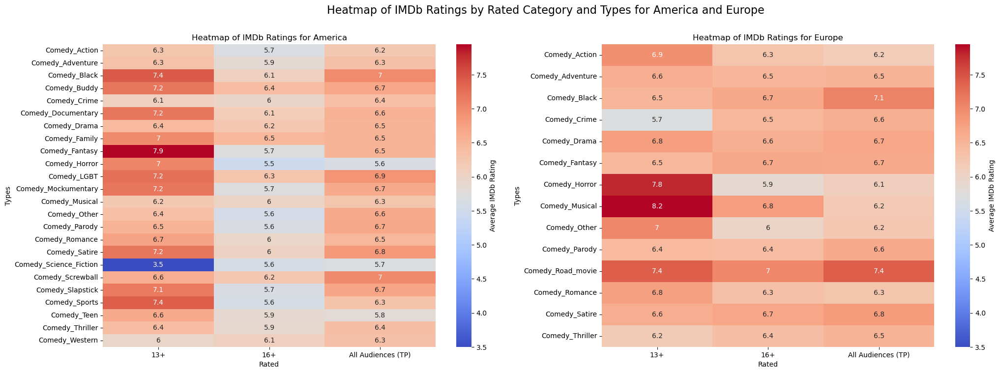

In [ ]:
# Explode the 'Types' column to separate multiple types into different rows
dataset_america_exploded = dataset_america.explode('Types')
dataset_europe_exploded = dataset_europe.explode('Types')

# Pivot the dataset to create a matrix for the heatmap
heatmap_data_america = dataset_america_exploded.pivot_table(index='Types', columns='Rated', values='imdbRating', aggfunc='mean')
heatmap_data_europe = dataset_europe_exploded.pivot_table(index='Types', columns='Rated', values='imdbRating', aggfunc='mean')

# Remove rows with NaN values from the heatmap data
heatmap_data_america.dropna(inplace=True)
heatmap_data_europe.dropna(inplace=True)

# Define a more intuitive categorical colormap
cmap = sns.color_palette("coolwarm", as_cmap=True)

# Create a figure with two subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 8))

# Plot the heatmap for America
sns.heatmap(heatmap_data_america, annot=True, cmap=cmap, cbar_kws={'label': 'Average IMDb Rating'}, ax=ax1, vmin=heatmap_data_america.values.min(), vmax=heatmap_data_america.values.max())
ax1.set_title('Heatmap of IMDb Ratings for America')
ax1.set_xlabel('Rated')
ax1.set_ylabel('Types')

# Plot the heatmap for Europe
sns.heatmap(heatmap_data_europe, annot=True, cmap=cmap, cbar_kws={'label': 'Average IMDb Rating'}, ax=ax2, vmin=heatmap_data_america.values.min(), vmax=heatmap_data_america.values.max())
ax2.set_title('Heatmap of IMDb Ratings for Europe')
ax2.set_xlabel('Rated')
ax2.set_ylabel('Types')

# Add a common label for both subplots
fig.suptitle('Heatmap of IMDb Ratings by Rated Category and Types for America and Europe', fontsize=16)

plt.show()




In [ ]:

import plotly.express as px

# Create an interactive heatmap for America
fig_america = px.imshow(heatmap_data_america, 
                        labels=dict(x="Rated", y="Types", color="Average IMDb Rating"),
                        x=heatmap_data_america.columns,
                        y=heatmap_data_america.index,
                        color_continuous_scale='RdBu_r',
                        aspect="auto")

fig_america.update_layout(title='Interactive Heatmap of IMDb Ratings for America')

# Create an interactive heatmap for Europe
fig_europe = px.imshow(heatmap_data_europe, 
                       labels=dict(x="Rated", y="Types", color="Average IMDb Rating"),
                       x=heatmap_data_europe.columns,
                       y=heatmap_data_europe.index,
                       color_continuous_scale='RdBu_r',
                       aspect="auto")

fig_europe.update_layout(title='Interactive Heatmap of IMDb Ratings for Europe')

# Show the interactive plots
fig_america.show()
fig_europe.show()

# Save the interactive heatmaps as HTML files
fig_america.write_html('interactive_heatmap_america.html')
fig_europe.write_html('interactive_heatmap_europe.html')

# Rating of Comedies : Critics vs Users

### Source of Ratings: Critics vs. Public

This table shows whether each rating source displays ratings from critics or the public.

| Rating Source                  | Type of Rating     | Description                                                                                       |
|--------------------------------|--------------------|---------------------------------------------------------------------------------------------------|
| **imdbRating**                 | Public             | Rating provided by IMDb users.                                                                    |
| **Rotten_Tomatoes_Rating**     | Critics            | Represents the **Tomatometer** score, an aggregated rating from professional critics.             |
| **Metacritic_Rating**          | Critics            | Aggregated rating from professional critics, provided by Metacritic.                              |

### Summary
- **Critics’ Ratings**: Rotten_Tomatoes_Rating (Tomatometer) and Metacritic_Rating.
- **Public Ratings**: imdbRating.




In [31]:
# Explode the 'Types' column to have one type per row
exploded_dataset = dataset_Genre_Cleaned.explode('Types')

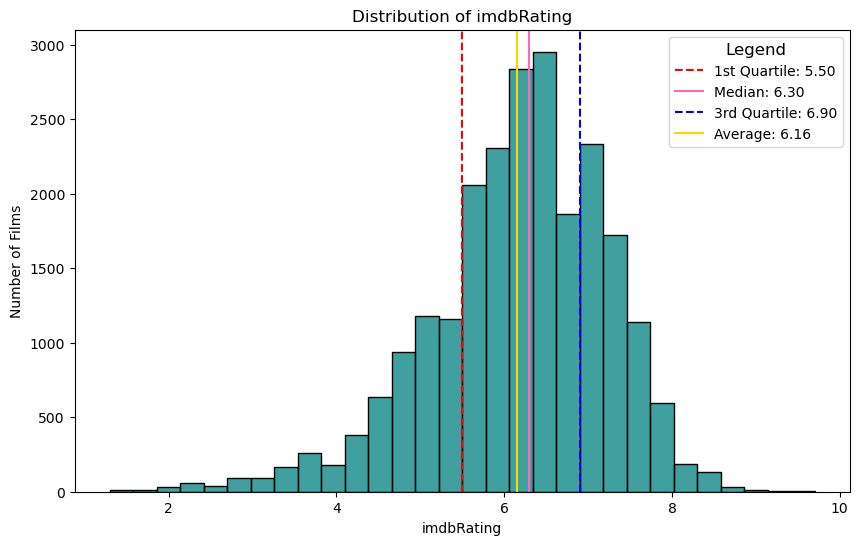

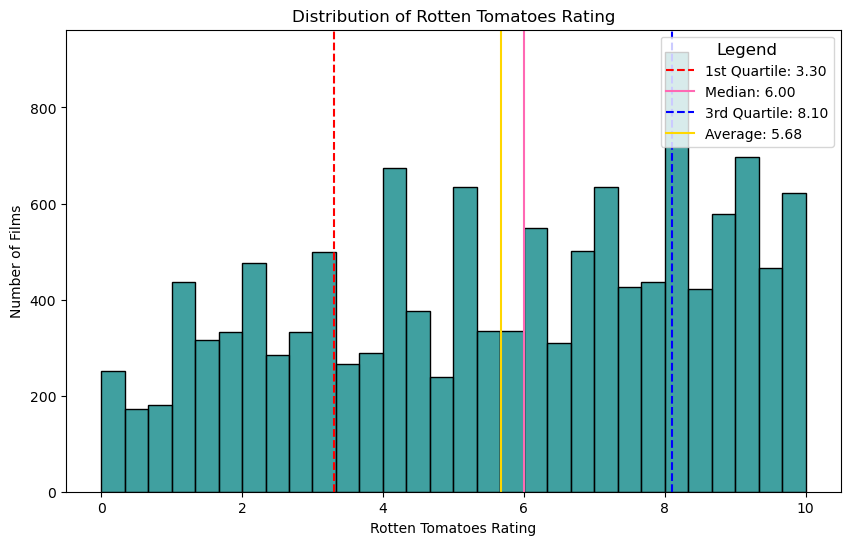

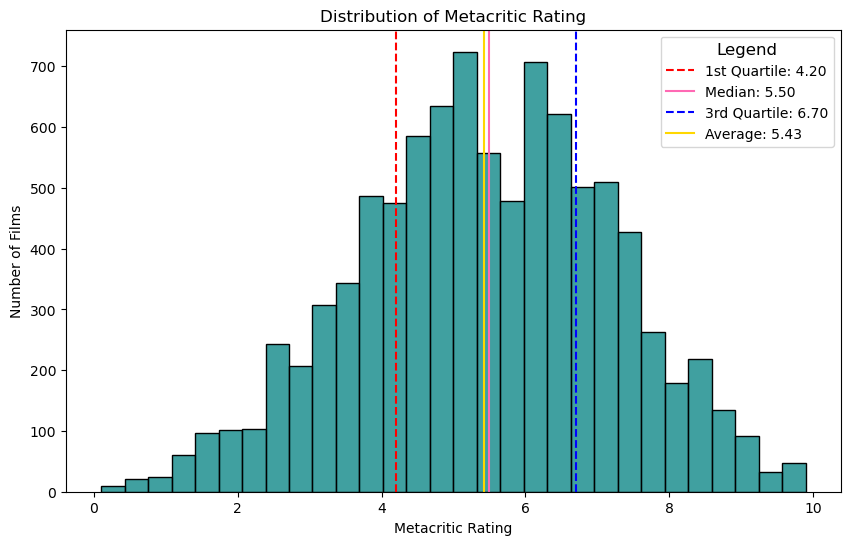

In [32]:
ratings_columns = ['imdbRating', 'Rotten_Tomatoes_Rating', 'Metacritic_Rating']

for rating in ratings_columns:
    plt.figure(figsize=(10, 6))
    sns.histplot(exploded_dataset[rating].dropna(), bins=30, kde=False, color='teal')
    plt.title(f'Distribution of {rating.replace("_", " ")}')
    plt.xlabel(rating.replace("_", " "))
    plt.ylabel('Number of Films')

    # Calculate and display the quartiles, median, and average of the ratings
    quartiles = exploded_dataset[rating].dropna().quantile([0.25, 0.5, 0.75])
    median = exploded_dataset[rating].dropna().median()
    average = exploded_dataset[rating].dropna().mean()

    plt.axvline(quartiles[0.25], color='r', linestyle='--', label='1st Quartile')
    plt.axvline(median, color='hotpink', linestyle='-', label='Median')
    plt.axvline(quartiles[0.75], color='b', linestyle='--', label='3rd Quartile')
    plt.axvline(average, color='gold', linestyle='-', label='Average')

    # Create a custom legend
    handles, labels = plt.gca().get_legend_handles_labels()
    labels = [f'1st Quartile: {quartiles[0.25]:.2f}', f'Median: {median:.2f}', f'3rd Quartile: {quartiles[0.75]:.2f}', f'Average: {average:.2f}']
    plt.legend(handles, labels, title='Legend', title_fontsize='large', loc='upper right')

    plt.show()

### Are the distributions normal ?

In [ ]:
for rating in ratings_columns :
    #print(dataset_Genre_Cleaned[rating].dropna().describe())
    
    # Perform the Kolmogorov-Smirnov test for normality on the 'IncomePerCap' column
    ks_statistic, p_value = diagnostic.kstest_normal(dataset_Genre_Cleaned[rating].dropna().values, dist='norm')
    print(f'Kolmogorov-Smirnov test for normality on {rating}: KS Statistic = {ks_statistic:.4f}, P-Value = {p_value:.4f}')

#### Kolmogorov-Smirnov Test for Normality on Movie Ratings

##### How the KS Test Works

1. **Define Hypotheses**:
   - **Null Hypothesis (H0)**: The data follows the specified distribution (e.g., normal distribution).
   - **Alternative Hypothesis (H1)**: The data does not follow the specified distribution.

2. **Calculate the KS Statistic**:
   - The KS statistic measures the maximum difference between the cumulative distribution of the sample data and the cumulative distribution of the normal distribution.
   - A larger KS statistic indicates a greater deviation between the sample data and the specified distribution.

3. **P-Value**:
   - The p-value tells us if the observed difference (measured by the KS statistic) is statistically significant.
   - A low p-value (typically < 0.05) means we can reject the null hypothesis and conclude that the data does not follow a normal distribution.
   - A high p-value (typically ≥ 0.05) means we fail to reject the null hypothesis, suggesting the data may follow a normal distribution.


### Results for Each Rating Source

| Rating Source                  | KS Statistic | P-Value | Interpretation                                                                                      |
|--------------------------------|--------------|---------|-----------------------------------------------------------------------------------------------------|
| **imdbRating**                 | 0.0648       | 0.0010  | The p-value of 0.001 suggests a significant deviation from normality, indicating this rating is not normally distributed. |
| **Rotten_Tomatoes_Rating**     | 0.0834       | 0.0010  | The highest KS statistic among all ratings, with a p-value of 0.001, suggesting a pronounced deviation from normality. |
| **Metacritic_Rating**          | 0.0350       | 0.0010  | Significant deviation from normality as indicated by the low p-value.                               |

### Summary

All ratings show p-values of 0.001, indicating that none of these datasets follow a normal distribution at a 0.05 significance level. The KS statistics for each rating source reinforce this conclusion, with **Rotten_Tomatoes_Rating** showing the highest deviation from normality. These results imply that assumptions of normality may not hold for analyses on these rating distributions.



## Analysis of Ratings: Do Critics Rate European Films More Severely Than Users? And the Same for American Films?



This analysis compares IMDb ratings (from users) with Rotten Tomatoes and Metacritic ratings (from critics) to determine if critics rate European and American films more severely than users.

### Methodology
- **Separate by Continent of Production**: The analysis is conducted separately for European and American films.
- **Combined Critic Ratings**: For each continent, Rotten Tomatoes and Metacritic ratings are combined into a single "Critics" group for analysis.
- **Statistical Tests**:
  - **Independent T-Test**: Used if both IMDb (user) and combined critics' ratings are normally distributed for each continent.
  - **Mann-Whitney U Test**: Used if the data is not normally distributed for each continent.
  
### Hypotheses

- **Null Hypothesis (H0)**: There is no difference between the ratings given by critics and users for films from each continent.
- **Alternative Hypothesis (H1)**: Critics rate films more severely than users for each continent, meaning critic ratings are lower than user ratings.

### Statistical Tests in Detail

#### Independent T-Test

The **Independent T-Test** compares the means of two independent groups (in this case, user ratings vs. critic ratings) to determine if there is a statistically significant difference between them.

- **Formula**:
  $
  t = \frac{\bar{X}_1 - \bar{X}_2}{\sqrt{\frac{s_1^2}{n_1} + \frac{s_2^2}{n_2}}}
  $
  Where:
  - $\bar{X}_1$ and $\bar{X}_2$ are the sample means for the two groups (users and critics).
  - $s_1^2$ and $s_2^2$ are the variances of the two groups.
  - $n_1$ and $n_2$ are the sample sizes of the two groups.

- **Assumptions**:
  - The data for each group should be normally distributed.
  - Variances of the two groups should be equal (if not, an adjusted version of the T-Test, known as Welch's T-Test, is used).

- **Interpretation of Results**:
  - If the p-value < 0.05, we reject the null hypothesis, suggesting a significant difference in mean ratings between critics and users.
  - If the p-value ≥ 0.05, we fail to reject the null hypothesis, indicating no significant difference in mean ratings.

#### Mann-Whitney U Test

If the data is not normally distributed, the **Mann-Whitney U Test** is a non-parametric alternative that compares the distributions of the two independent groups.

- **Formula**:
  $
  U = n_1 n_2 + \frac{n_1 (n_1 + 1)}{2} - R_1
  $
  Where:
  - $U$ is the test statistic.
  - $n_1$ and $n_2$ are the sample sizes of the two groups.
  - $R_1$ is the sum of ranks for the first group (users).

- **Interpretation of Results**:
  - If the p-value < 0.05, we reject the null hypothesis, indicating a significant difference in the distributions of ratings between critics and users.
  - If the p-value ≥ 0.05, we fail to reject the null hypothesis, suggesting no significant difference in distributions.

### Interpretation of Results
- **If p-value < 0.05**: Reject the null hypothesis, suggesting that critics rate films from that continent more severely than users.
- **If p-value ≥ 0.05**: Fail to reject the null hypothesis, indicating no significant difference between user and critic ratings for films from that continent.

### Summary

- **Independent T-Test** is used if ratings for each group (user and critic) are normally distributed.
- **Mann-Whitney U Test** is used as an alternative if data is not normally distributed.




In [ ]:
# Filter the dataset for the continents 'Europe' and 'America'
filtered_dataset = exploded_dataset.loc[exploded_dataset['Continents'].isin(['Europe', 'America'])]

# Separate user and critic ratings for each continent
europe_user_ratings = filtered_dataset[(filtered_dataset['Continents'] == 'Europe')]['imdbRating'].dropna()
europe_critic_ratings = filtered_dataset[(filtered_dataset['Continents'] == 'Europe')][['Rotten_Tomatoes_Rating', 'Metacritic_Rating']].dropna().values.flatten()
america_user_ratings = filtered_dataset[(filtered_dataset['Continents'] == 'America')]['imdbRating'].dropna()
america_critic_ratings = filtered_dataset[(filtered_dataset['Continents'] == 'America')][['Rotten_Tomatoes_Rating', 'Metacritic_Rating']].dropna().values.flatten()

# Define a function to perform the test based on normality
def compare_ratings(user_ratings, critic_ratings, continent):
    # Check normality to decide on the test
    if stats.shapiro(user_ratings).pvalue > 0.05 and stats.shapiro(critic_ratings).pvalue > 0.05:
        # If both distributions are normal, use an independent T-Test
        t_stat, p_value = stats.ttest_ind(user_ratings, critic_ratings, alternative='greater', equal_var=False)
        test_name = "T-Test"
    else:
        # Use Mann-Whitney U Test if data is not normally distributed
        u_stat, p_value = stats.mannwhitneyu(user_ratings, critic_ratings, alternative='greater')
        test_name = "Mann-Whitney U Test"
    
    # Output the results
    print(f"\n{test_name} Results for {continent} Films:")
    print(f"P-Value: {p_value}")
    if p_value < 0.05:
        print("Result: Critics rate films more severely than users (significant difference).")
    else:
        print("Result: No significant difference between critics' and users' ratings.")

# Run the test for Europe
compare_ratings(europe_user_ratings, europe_critic_ratings, "European")

# Run the test for America
compare_ratings(america_user_ratings, america_critic_ratings, "American")

### Summary of Mann-Whitney U Test Results: Do Critics Rate Films More Severely Than Users?

This table summarizes the results of the Mann-Whitney U Test comparing user and critic ratings for European and American films.

| Continent        | Test Statistic  | P-Value                   | Interpretation                                                                                           |
|------------------|-----------------|---------------------------|----------------------------------------------------------------------------------------------------------|
| **European Films** | Mann-Whitney U | 0.9999999999998804        | No significant difference between critics' and users' ratings; critics and users rate European films similarly. |
| **American Films** | Mann-Whitney U | 6.65e-192                 | Significant difference; critics rate American films more severely than users.                             |

### Additional Notes
- **Warning**: The large sample size (N > 5000) may impact the accuracy of the p-values, as indicated by a warning from the test. However, the results remain interpretable, especially for indicating significant differences.


# Are European Comedies Juged Better Than American Comedies

In [ ]:
for rating in ratings_columns:    
    europe_ratings = dataset_Genre_Cleaned.loc[dataset_Genre_Cleaned['Continents'] == 'Europe'][rating].dropna()
    america_ratings = dataset_Genre_Cleaned.loc[dataset_Genre_Cleaned['Continents'] == 'America'][rating].dropna()
    print("The rating of",rating, " " ,stats.ttest_ind(europe_ratings, america_ratings))

## T-Test Analysis of Ratings by Continent of Production



This analysis compares the average ratings of comedies produced in Europe and America using an independent t-test to determine if there are statistically significant differences in ratings based on the continent of production.

### Results

| Rating Source                  | T-Test Statistic | P-Value               | Degrees of Freedom | Interpretation                                                                                      |
|--------------------------------|------------------|-----------------------|--------------------|-----------------------------------------------------------------------------------------------------|
| **imdbRating**                 | 9.283            | 1.97e-20              | 10,443             | Significant difference in IMDb ratings between European and American-produced comedies, suggesting differing rating patterns. |
| **Rotten_Tomatoes_Rating**     | 13.356           | 6.86e-40              | 4,260              | Strongest observed difference, with a very high t-statistic, showing marked rating variation based on the continent of production. |
| **Metacritic_Rating**          | 10.086           | 1.57e-23              | 2,842              | Significant difference in ratings between European and American-produced comedies, similar to Rotten Tomatoes.           |

### Summary

All rating sources demonstrate statistically significant differences between comedies produced in Europe and America. This suggests that the continent of production may strongly influence movie ratings on these platforms. With very low p-values (all well below 0.05), we can be confident that these differences are not due to random chance and reflect actual rating patterns that vary by continent of production.


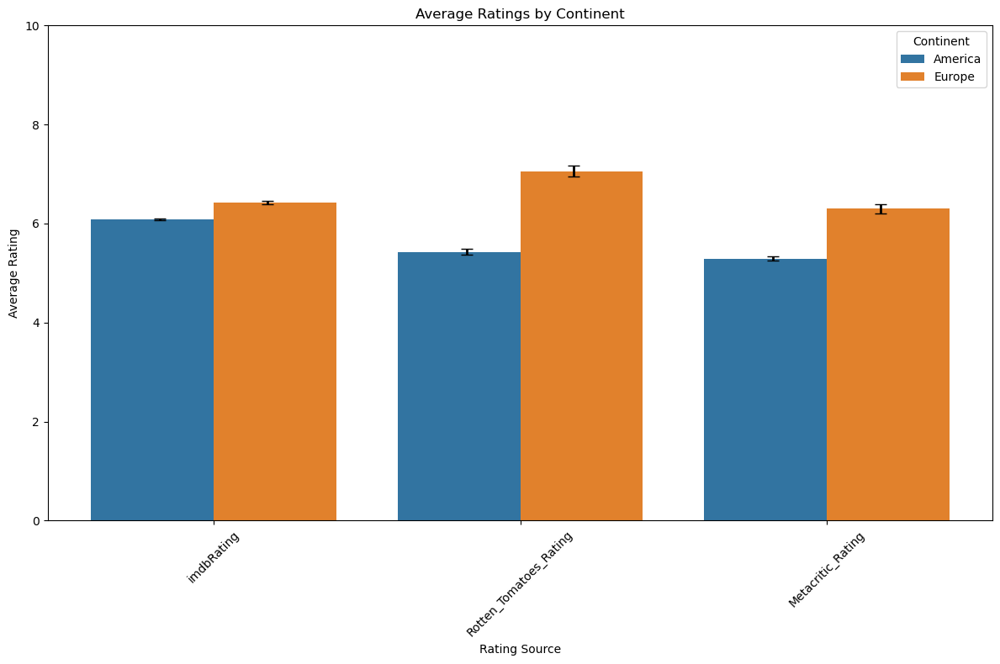

In [36]:
# Filter the dataset for the continents 'Europe' and 'America'
filtered_dataset = exploded_dataset.loc[exploded_dataset['Continents'].isin(['Europe', 'America'])]

# Calculate the average rating per continent, ignoring NaNs
average_ratings = filtered_dataset.groupby('Continents')[ratings_columns].mean().reset_index()

# Melt the dataframe for easier plotting with seaborn
melted_ratings = average_ratings.melt(id_vars='Continents', var_name='Rating_Source', value_name='Average_Rating')

# Divide the Metascore and its confidence intervals by 10 for better comparison
melted_ratings.loc[melted_ratings['Rating_Source'] == 'Metascore', 'Average_Rating'] /= 10

# Calculate the confidence intervals, excluding NaNs
conf_intervals = filtered_dataset.groupby('Continents')[ratings_columns].agg(
    lambda x: stats.t.interval(0.95, len(x.dropna())-1, loc=np.mean(x.dropna()), scale=stats.sem(x.dropna()))
)

# Prepare the plot
plt.figure(figsize=(12, 8))
ax = sns.barplot(x='Rating_Source', y='Average_Rating', hue='Continents', data=melted_ratings, errorbar=None)
plt.ylim([0, 10])
plt.title('Average Ratings by Continent')
plt.xlabel('Rating Source')
plt.ylabel('Average Rating')

# Width of each bar group, adjust if necessary based on Seaborn's bar width
bar_width = 0.35

# Add error bars in black, centered within each bar
for j, rating_source in enumerate(ratings_columns):
    for i, continent in enumerate(average_ratings['Continents']):
        lower_bound, upper_bound = conf_intervals.loc[continent, rating_source]
        y_value = average_ratings.loc[average_ratings['Continents'] == continent, rating_source].values[0]
        
        # If rating source is Metascore, adjust y_value accordingly
        if rating_source == "Metascore":
            y_value /= 10
        
        # Calculate the x position centered for each bar in the group
        x_pos = j - bar_width/2 + i * bar_width
        
        # Plot the error bar in black
        ax.errorbar(x=x_pos, y=y_value, 
                    yerr=[[y_value - lower_bound], [upper_bound - y_value]], 
                    fmt='none', c='black', capsize=5, lw=2)

plt.legend(title='Continent')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
# Loop through each rating in the ratings columns and print detailed confidence interval information
for rating in ratings_columns:
    europe_ci = conf_intervals.loc['Europe', rating]
    america_ci = conf_intervals.loc['America', rating]
    
    print(f"\n### {rating} ###")
    print(f"Europe Confidence Interval: {europe_ci}")
    print(f"America Confidence Interval: {america_ci}")
    
    # Check if intervals overlap
    if europe_ci[0] > america_ci[1] or america_ci[0] > europe_ci[1]:
        print("Interpretation: The confidence intervals do not overlap, indicating a statistically significant difference.")
    else:
        print("Interpretation: The confidence intervals overlap, suggesting no statistically significant difference.")

## Confidence Interval Analysis of Movie Ratings by Continent of Production



This table summarizes the confidence intervals (CIs) for movie ratings of comedies produced in Europe and America across various rating sources. The non-overlapping confidence intervals indicate statistically significant differences in average ratings between the continents of production.

| Rating Source               | Europe CI                  | America CI                | Interpretation                                                                                                                                                             |
|-----------------------------|----------------------------|---------------------------|---------------------------------------------------------------------------------------------------------------------------------------------------------------------------|
| **imdbRating**              | (6.39, 6.45)               | (6.07, 6.10)             | Non-overlapping intervals suggest a significant difference, with European-produced comedies rated slightly higher than American-produced comedies on IMDb.                                       |
| **Rotten_Tomatoes_Rating**  | (6.95, 7.16)               | (5.37, 5.48)             | Significant difference indicated by non-overlapping intervals, with European comedies receiving notably higher ratings on Rotten Tomatoes compared to American comedies.                     |
| **Metacritic_Rating**       | (6.20, 6.40)               | (5.25, 5.33)             | Non-overlapping intervals show a statistically significant difference, with European comedies rated higher than American comedies on Metacritic.                                         |

### Summary of Findings
- **Statistically Significant Differences**: All rating sources show non-overlapping confidence intervals between European and American comedies, indicating significant differences in average ratings based on the continent of production.
- **Higher Ratings for European Comedies**: European-produced comedies have consistently higher ratings across all platforms compared to American-produced comedies, reflecting potential cultural or perceptual differences in movie appreciation.
- **Implications**: These findings are essential for cross-continental comparisons of movie ratings, as production region appears to impact ratings and may reflect different preferences or rating standards across platforms.


# <h1 style="text-align:center; color: #32CD32;">AXE 2 : Narrative Themes and Movie Plots Analysis 📖🎥</h1>


In this axis, we aim at focusing on a more Natural Language Processing (NLP) strategy to process the CMU movie dataset.

In [ ]:
# Load Data and Plot Summaries
DATASET_FILEPATH = Path("data/merged_movie_metadata.csv")
PLOT_SUMMARIES_FILEPATH = Path("../MovieSummaries/plot_summaries.txt")

df = pd.read_csv(DATASET_FILEPATH)

# Take only unique Wikipedia_ID
df = df.drop_duplicates(subset=['Wikipedia_ID'])

plot_summaries = {}

with open(PLOT_SUMMARIES_FILEPATH, 'r', encoding='utf-8') as file:
    for line in file:
        parts = line.strip().split('\t', 1)
        if len(parts) == 2:
            wiki_id, summary = parts
            plot_summaries[int(wiki_id)] = summary

# Map plot summaries to the DataFrame
df['Plot_Summary_Base'] = df['Wikipedia_ID'].map(plot_summaries)

### Loading and Preparing Movie Plot Summaries

Our dataset includes two main sources for movie plot summaries:

1. **OMDB Data (Plot column)**: This source provides a brief summary of the movie plot in a few sentences.
2. **CMU Movie Summary Corpus (plot_summaries.txt)**: This file, obtained from the [CMU Movie Summary Corpus website](https://www.cs.cmu.edu/~ark/personas/), contains detailed plot summaries for a range of movies.

Since both sources may contain missing values for certain movies, we will combine the two to maximize coverage and ensure we have plot information for as many movies as possible. Below is a check to see how many values are missing in each plot source:

In [39]:
# Check missing values in both plot sources
print(f"Total movies: {len(df)}")
print(f"Missing values in OMDB Plot column: {df['Plot'].isna().sum()}")
print(f"Missing values in CMU Plot Summary column: {df['Plot_Summary_Base'].isna().sum()}")

# Movies missing both plot summaries
print(f"Movies missing both summaries: {(df['Plot'].isna() & df['Plot_Summary_Base'].isna()).sum()}")

Total movies: 11681
Missing values in OMDB Plot column: 423
Missing values in CMU Plot Summary column: 4076
Movies missing both summaries: 362


## Additionnal dataset

For our journey, we will need to retrieve an aditionnal dataset from the internet. We will get it from OMDB [Open Movie Database](https://www.omdbapi.com), an open API that allows to retrieve movie metadata from their IMDBId, or even simpler, from their title.

After getting an API key, we managed to query the database for $73'000$ movies out of the $\approx 83'000$ original movies of `movie_metadata.tsv` from CoreNLP.

The resulting `.json` file was merged with the original CoreNLP dataset, adding the following columns :

    ["Rated", "Director", "Writer", "Actors", "Plot", "Awards", "Poster", "Ratings", "Metascore", "imdbRating", "imdbVotes", "imdbID", "DVD", "Production", "Website", "Response", "totalSeasons", "Oscar", "Nomination_Awards", "Win_Awards", "Internet_Movie_Database_Rating", "Rotten_Tomatoes_Rating", "Metacritic_Rating"]

We can then process to our text-based analysis.

### Text Preprocessing for Movie Plots

To analyze movie plots, we need to process the text data to standardize and clean it. We perform several key steps in this process:

1. **Text selection** - For each movie, we prioritize plot summaries from the [CMU Movie Summary Corpus](https://www.cs.cmu.edu/~ark/personas/) because they tend to be richer in content. If a summary from this source is unavailable (i.e., a missing value), we use the summary from OMDB. If both sources are missing, the result will be marked as `NaN`.
   
2. **Tokenization** We split each plot summary into individual words (tokens).

3. **Stop words removal** Commonly used words that don’t contribute meaningful information (known as stop words) are removed. Examples of stop words include "the," "is," "and," "in," "to," etc.

4. **Lemmatization** Each word is reduced to its base or root form. For instance, words like "running," "runs," and "ran" are all converted to "run". This helps improve the accuracy of our analysis by avoiding duplicates in different forms. This process is called.

5. **Frequency analysis** We analyze the frequency and type of words used.


In [ ]:
# Text Preprocessing
from src.utils.data_utils import tok_by_region

# Tokenize plots by region
tokenized_plots_america = tok_by_region(df, 'America')
tokenized_plots_europe = tok_by_region(df, 'Europe')
tokenized_plots_both = tok_by_region(df, 'Both')

We now want to see the most frequently used words in movie plots across our three regions: **America**, **Europe**, and **Both**. We use a `Counter` to count occurrences of each word in the tokenized plots for each region.

In [ ]:
# Word Counts
from src.utils.data_utils import get_word_count

word_count_america = get_word_count(tokenized_plots_america)
word_count_europe = get_word_count(tokenized_plots_europe)
word_count_both = get_word_count(tokenized_plots_both)

print("Top 10 words in America:", word_count_america.most_common(10))
print("\nTop 10 words in Europe:", word_count_europe.most_common(10))
print("\nTop 10 words in Both:", word_count_both.most_common(10))

Top 10 words in America: [('get', 6140), ('find', 5148), ('go', 5088), ('one', 4688), ('back', 4513), ('take', 4335), ('new', 3921), ('tell', 3897), ('friend', 3740), ('two', 3736)]

Top 10 words in Europe: [('one', 895), ('film', 878), ('get', 846), ('find', 821), ('go', 774), ('life', 772), ('take', 734), ('two', 722), ('friend', 682), ('love', 634)]

Top 10 words in Both: [('find', 642), ('get', 574), ('go', 561), ('one', 544), ('take', 494), ('two', 459), ('back', 448), ('tell', 441), ('new', 408), ('film', 407)]


We now have the most frequently used words in each region’s plot summaries, but these results feel somewhat limited. To gain deeper insights, we’ll use the Stanford CoreNLP-processed summaries, which provide richer linguistic information.

These summaries, derived from `plot_summaries.txt`, have been processed with the [Stanford CoreNLP pipeline](https://stanfordnlp.github.io/CoreNLP/), a tool that performs advanced language processing tasks such as part-of-speech tagging, syntactic parsing, named entity recognition (NER), and coreference resolution. This additional information will allow us to analyze not only word frequency but also the context and roles of words within each summary. We will first extract the **POS tags**.

First, let's configure the folder where we store these summaries (not included in github due to the large space it takes) :

In [42]:
folder_path = Path("../corenlp_plot_summaries_augmented")

assert folder_path.exists(), "Must configure the correct path to corenlp_plot_summaries"

Then, let's see how many movies that have their summaries processed.

 > **Note :** originally, only ~7'000 movies were processed. We added 3'500 missing movies by processing their OMDB plot summaries instead. This was a bit of a headache and since this is preprocessing, the logic was moved inside `src/scripts/` to lighten the notebook. See [extract_ids_to_run_in_pipeline.py](src/scripts/extract_ids_to_run_in_pipeline.py) and [INTELLIJ_run_Stanford_Pipeline.xml](src/scripts/INTELLIJ_run_Stanford_Pipeline.xml) for details on how this was achieved.

In [43]:
# count matching folders/files
processed_ids = {f.stem.replace(".xml", "") for f in folder_path.glob("*.xml.gz")}
available_ids = set(df["Wikipedia_ID"].astype(str))
matching_files = [folder_path/f"{filename}.xml.gz" for filename in processed_ids.intersection(available_ids)]

print(f"Number of matching folders/files: {len(matching_files)}")
print(f"Number of unique Wiki id's: {df['Wikipedia_ID'].nunique()}")

Number of matching folders/files: 11319
Number of unique Wiki id's: 11681


### Filter using the POS fields

**POS (Part Of Speech) fields contains word metadata. It indicates whether the current word is a noun, a verb, an adjective, etc.**

[An example POS definition can be found here](https://en.wikipedia.org/wiki/Brown_Corpus#Part-of-speech_tags_used) :

![POS example definition](src/ressource/POS_tokens_BrownCorpusWikipedia.png)

We need to know what kind of fields we have in our files to extract the most useful ones for our analysis. To do so, and to avoid unzipping all the xml files to the computer, we can leverage bash tools and use this (non-optimized) command. However, even if this method is (quiet) efficient, it would still take a long time to process all the files. Since we use this command only to get a grasp of the POS fields, we executed it on a subset of files chosen randomly. We just replace "*xml.gz" with the first 5000 files after being sorted randomly.


```bash
    zcat  $(ls *.xml.gz | sort -R | head -n5000) | grep -oP "(?<=<POS>)[^<]+" | sort | uniq -c | sort -rn
```

How it works :
 - `$(ls *.xml.gz | sort -R | head -n5000)` returns 5000 randomly chosen filenames inside the current directory.
 - `zcat` displays the content of a .gz (gzipped) file as text
 - The output is piped to `grep` which extracts all the POS fields as strings : "(...) <POS>NN</POS> (...)" => "NN" 
 - The output is piped to `sort` which sorts this sequence of strings
 - The output is piped to `uniq` which prints each string only once, preceded with its number of occurences
 - The output is piped to `sort` which sorts the list of string occurences by descending order.


Which gives as output :

```text
     250061 NN
     185484 IN
     164548 NNP
     162675 DT
     116598 VBZ
      93384 ,
     [...]
```

We redirect the output to a file `data/POS_tokens.csv` and read it with pandas :



<Figure size 1000x600 with 0 Axes>

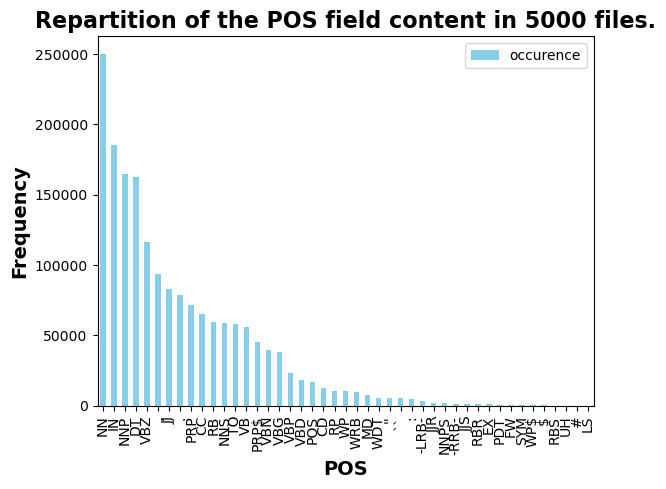

In [44]:
df_pos = pd.read_csv("data/POS_tokens.csv", sep=" ", header=None)
df_pos.columns = ["occurence", "token"]
plt.figure(figsize=(10, 6))
df_pos.plot(x='token', y='occurence', kind='bar', color='skyblue')
plt.title(f'Repartition of the POS field content in 5000 files.', fontdict={'fontsize': 16, 'fontweight': 'bold'})
plt.xlabel('POS', fontdict={'fontsize': 14, 'fontweight': 'bold'})
plt.ylabel('Frequency', fontdict={'fontsize': 14, 'fontweight': 'bold'})
plt.xticks(rotation=90)
plt.show()

Now that we have a clear idea of the most commonly used POS tags, we can use this information to focus on the tags that will be most relevant and insightful for our analysis. 
Let's now see how many films in our dataset have gone through the Stanford CoreNLP pipeline:

### Running the CoreNLP pipeline on the OMDB plots summaries (fallback)

Out of a total of 11'681 films, 11'319 have been processed through the Stanford CoreNLP pipeline.

To work with the Stanford CoreNLP-processed data, we define the following functions:

1. **`get_sentence_word_metadata`**:
   - This function retrieves metadata from the CoreNLP pipeline output for a given movie ID. 
   - It extracts tokens, their lemmas, and part-of-speech (POS) tags from `.xml.gz` files.

2. **`filter_words_by_pos`**:
   - This function filters tokens based on specified POS tags, allowing us to focus on particular types of words, such as nouns, verbs, or adjectives.

3. **`filter_words_by_pos_ngram`**:
   - This function generates n-grams (sequences of n consecutive words) from the tokenized data, filtered by the specified POS tags. It is useful for capturing patterns and contexts in the text.

We also define three sets of ids for each region ("Europe", "America" or both of them).

In [ ]:
from src.utils.data_utils import filter_words_by_pos, filter_words_by_pos_ngram, get_sentence_word_metadata

# Define Regions
region_ids = {
    "America": set(df[df['Continents'].str.contains("America")]['Wikipedia_ID'].astype(str)),
    "Europe": set(df[df['Continents'].str.contains("Europe")]['Wikipedia_ID'].astype(str)),
    "Both": set(df[df['Continents'].str.contains("Both")]['Wikipedia_ID'].astype(str))
}

After we've successfully extracted the words we wanted, the next step is to visualize them. To do this, we will use a word cloud visualization to display the most frequent words. In a word cloud, word size represent their frequency of occurence. This gives immediately a grasp of the word occurences.

In [ ]:
# Word Cloud Generation
def generate_word_cloud(region, pos_tags, title, mask_image=None, sample_output=True, ngrams=1):
    """Generates a word cloud for a specified region and POS tags, with optional mask and sample output."""
    word_counter = Counter()
    for wiki_id in tqdm(region_ids[region]):
        tokens_metadata = get_sentence_word_metadata(folder_path, wiki_id)
        filtered_words = filter_words_by_pos(tokens_metadata, pos_tags) if ngrams == 1 else filter_words_by_pos_ngram(tokens_metadata, pos_tags, ngrams)
        word_counter.update(filtered_words)
    
    if sample_output:
        # print sample output for verification
        print(f"\nSample of filtered words for {region} - {title}:")
        print(word_counter.most_common(10))
    
    # word_counter.subtract(word_counter.most_common(6))
    
    # generate and display the word cloud with mask if provided
    wordcloud = WordCloud(width=800, height=400, background_color='white', mask=mask_image,
                          contour_color='black', contour_width=1).generate_from_frequencies(word_counter)
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f"{title} Word Cloud for {region}")
    plt.show()

Using the POS tags defined above, we can group the tags into specific categories (e.g., nouns, verbs, adjectives) to filter tokens for our word cloud.

In [ ]:
# POS Tags Groups
noun_tags = ['NN', 'NNA', 'NNC', 'NNS', 'NNP', 'NNPS']
verb_tags = ['VB', 'VBD', 'VBG', 'VBN', 'VBP', 'VBS', 'VBZ']
adjective_tags = ['JJ', 'JJR', 'JJS', 'JJC', 'JJA', 'JJF', 'JJM']

# Word Cloud Mask Images
americas_mask = np.array(Image.open("src/ressource/Location_North_America.png"))
europe_mask = np.array(Image.open("src/ressource/Location_Europe.png"))
both_mask = np.array(Image.open("src/ressource/Location_Both.png"))

100%|██████████| 8595/8595 [02:14<00:00, 63.83it/s] 



Sample of filtered words for America - Nouns in America:
[('New York', 1011), ('love with', 737), ('order to', 683), ('way to', 510), ('attempt to', 474), ('end of', 414), ('rest of', 409), ('house and', 384), ('group of', 375), ('relationship with', 372)]


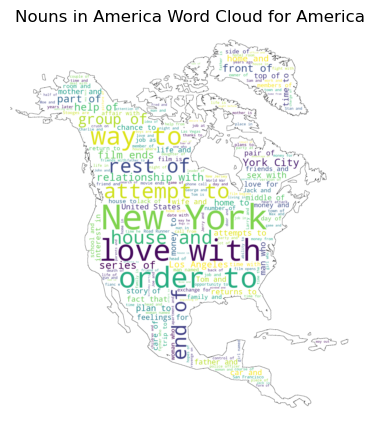

100%|██████████| 2444/2444 [00:23<00:00, 103.96it/s]



Sample of filtered words for Europe - Verbs in Europe:
[('is a', 514), ('has been', 235), ('tries to', 226), ('is the', 222), ('decides to', 216), ('goes to', 162), ('does not', 151), ('has a', 147), ('is not', 141), ('trying to', 131)]


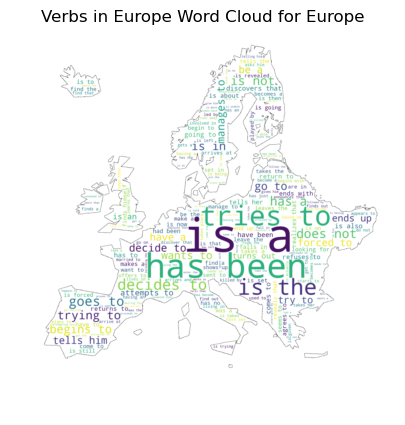

In [48]:
# Generate Word Clouds
generate_word_cloud("America", noun_tags, "Nouns in America", mask_image=americas_mask, ngrams=2)
generate_word_cloud("Europe", verb_tags, "Verbs in Europe", mask_image=europe_mask, ngrams=2)

### [Experimental!] Applying Topic Modeling using LDA
We aim to uncover the underlying themes in movie plot summaries from the **America**, **Europe**, and **Both** datasets using **Latent Dirichlet Allocation (LDA)**. This approach allows us to explore and compare thematic similarities and differences across regions. The methodology is inspired by this TDS article: [End-to-End Topic Modeling in Python](https://towardsdatascience.com/end-to-end-topic-modeling-in-python-latent-dirichlet-allocation-lda-35ce4ed6b3e0).

We preprocessed the plot data by tokenizing, lemmatizing, and removing stopwords. These cleaned tokens are joined into complete strings and combined into a single corpus (**America**, **Europe**, and **Both**) to create a shared vocabulary using the `TfidfVectorizer`.

This shared vocabulary ensures consistent representation of words and phrases across all datasets. After fitting the vectorizer, we transform each region’s text into numerical representations (TF-IDF matrices). This allows us to analyze and compare themes and topics uniformly across regions.

In [49]:
documents_america = tokenized_plots_america.dropna().apply(lambda tokens: ' '.join(tokens))
documents_europe = tokenized_plots_europe.dropna().apply(lambda tokens: ' '.join(tokens))
documents_both = tokenized_plots_both.dropna().apply(lambda tokens: ' '.join(tokens))

all_documents = pd.concat([documents_america, documents_europe, documents_both])

In [50]:
# Fit vectorizer on the combined corpus
vectorizer = TfidfVectorizer(
    max_features=5000,
    stop_words='english',
    min_df=5,
    max_df=0.85,
    ngram_range=(1, 2)
)
vectorizer.fit(all_documents)

# Transform each region separately
tfidf_america = vectorizer.transform(documents_america)
tfidf_europe = vectorizer.transform(documents_europe)
tfidf_both = vectorizer.transform(documents_both)

We fit separate **Latent Dirichlet Allocation (LDA)** models for each region using their respective TF-IDF matrices. Each model identifies 3 latent topics (`n_components=3`) within the text data for its region. 


In [51]:
# Fit LDA models
lda_america = LatentDirichletAllocation(n_components=3, random_state=42)
lda_america.fit(tfidf_america)

lda_europe = LatentDirichletAllocation(n_components=3, random_state=42)
lda_europe.fit(tfidf_europe)

lda_both = LatentDirichletAllocation(n_components=3, random_state=42)
lda_both.fit(tfidf_both)

LatentDirichletAllocation(n_components=3, random_state=42)

We use the `display_topics` function to extract and print the top words for each topic generated by the LDA models. 

This function:
1. Loops through each topic in the model.
2. Selects the top `no_top_words` most important words for the topic (based on their weights).
3. Prints these words to summarize the theme of each topic.

The `tfidf_feature_names`, which represent the vocabulary created by the `TfidfVectorizer`, are used to map the word indices back to their original terms.

In [52]:
def display_topics(model, feature_names, no_top_words=10):
    for topic_idx, topic in enumerate(model.components_):
        print(f"Topic {topic_idx + 1}:")
        print(" ".join([feature_names[i] for i in topic.argsort()[-no_top_words:]]))

tfidf_feature_names = vectorizer.get_feature_names_out()

print("America Topics:")
display_topics(lda_america, tfidf_feature_names)

print("\nEurope Topics:")
display_topics(lda_europe, tfidf_feature_names)

print("\nBoth Topics:")
display_topics(lda_both, tfidf_feature_names)

America Topics:
Topic 1:
gangster war expand hardy laurel detective murder ollie luke stan
Topic 2:
house home end try time tom make father friend new
Topic 3:
school comedy friend family girl woman film love life young

Europe Topics:
Topic 1:
life fall love war people man young wife love british woman
Topic 2:
girl family father woman london young friend life man film
Topic 3:
friend man daughter family film italian love wife young life

Both Topics:
Topic 1:
wilbur fictitious agent manor burton evan stash dude wilson holmes
Topic 2:
friend father young new man love woman family life film
Topic 3:
eve chucky big jess ballet dennis tip african vince gambler


The results are still somewhat messy, but we can infer some patterns. For example, **Topic 1** from the America dataset seemts to relate to crime and detective themes. However, the other topics are less clear and need refinement. This was just an initial experiment, and we aim to improve the results by tweaking the parameters and preprocessing steps in future iterations.

### PyLDAvis Visualization

1. **Intertopic Distance Map (Left Panel)**:
   - Each circle represents a topic, and its size reflects how prevalent the topic is in the dataset.
   - The distance between circles shows how distinct the topics are (closer = more similar, farther = more different).

2. **Top-30 Relevant Terms (Right Panel)**:
   - Displays the most relevant words for the selected topic.
   - **Red bars**: Frequency of the word within the selected topic.
   - **Blue bars**: Overall frequency of the word across the dataset.

3. **λ Slider**:
   - Adjusts the balance between specificity and frequency of terms.
   - **λ = 1**: Shows terms unique to the topic.
   - **λ = 0**: Shows more general terms that are common in the dataset.

In [53]:
# For America
pyLDAvis.enable_notebook()
vis_america = pyLDAvis.lda_model.prepare(lda_america, tfidf_america, vectorizer)
pyLDAvis.display(vis_america)

# For Europe
vis_europe = pyLDAvis.lda_model.prepare(lda_europe, tfidf_europe, vectorizer)
pyLDAvis.display(vis_europe)


# For Both
vis_both = pyLDAvis.lda_model.prepare(lda_both, tfidf_both, vectorizer)
pyLDAvis.display(vis_both)

# <h1 style="text-align:center; color: #4164F0;">AXE 3 : Gender and Ethnic Representation 🤝🕊️</h1>

This part of the project aims to shed light on potential gender disparities and ethnic diversity in the American and European movie industy. Choosing this angle to look at the differences between the America and Europe will shed light on a serious topic, inculsion and equality, through the study of a comedic vehicule, Comedy.
We see very different proportions for ethic repartition of actors in European and American movies. <br>
Reaserch will focus on:
- The evolution of varying proportions of gender and ethnicity at different time periods in the two movie industries.
- The types of comedies where a significantly different proportion is observed on the two contients.
- Look for correlations in movie recognition (boxoffice/rankings/ratings/awards) and diversity in the cast.

### Loading and Preparing the Movie Actor Gender Data and Movie Actor Ethnicity Data

In [ ]:
MOVIE_METADATA_PATH= '../MovieSummaries/movie.metadata.tsv'
CHARACTER_METADATA_PATH= '../MovieSummaries/character.metadata.tsv'
MERGED_MOVIE_METADATA_PATH='data/merged_movie_metadata.csv'

# Load data
movie_metadata = pd.read_csv(MOVIE_METADATA_PATH, sep='\t', header=None, names=['Wikipedia_ID', 'Freebase_ID', 'Movie_Name', 'Release_Date', 'Box_Office_Revenue', 'Runtime', 'Languages', 'Countries', 'Genres'])

character_metadata = pd.read_csv(CHARACTER_METADATA_PATH, sep='\t', header=None, names=['Wikipedia_ID', 'Freebase_ID', 'Release_Date', 'Character_Name', 'Actor_Birth_Date', 'Actor_Gender', 'Actor_Height', 'Actor_Ethnicity', 'Actor_Name', 'Actor_Age', 'Character_Actor_Freebase_ID', 'Character_Freebase_ID', 'Actor_Freebase_ID'])

full_movie_metadata = pd.read_csv(MERGED_MOVIE_METADATA_PATH)

In [55]:
print("=====MOVIE METADATA=====")
display(movie_metadata.shape, movie_metadata.head(2))
print("=====CHAR. METADATA=====")
display(character_metadata.shape,character_metadata.head(2))
print("=====MERGED MOVIE METADATA=====")
display(full_movie_metadata.shape, full_movie_metadata.head(2))

=====MOVIE METADATA=====


(81741, 9)

,Wikipedia_ID,Freebase_ID,Movie_Name,Release_Date,Box_Office_Revenue,Runtime,Languages,Countries,Genres
0,975900,/m/03vyhn,Ghosts of Mars,2001-08-24,14010832.0,98.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}","{""/m/01jfsb"": ""Thriller"", ""/m/06n90"": ""Science..."
1,3196793,/m/08yl5d,Getting Away with Murder: The JonBenét Ramsey ...,2000-02-16,NaN,95.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}","{""/m/02n4kr"": ""Mystery"", ""/m/03bxz7"": ""Biograp..."


=====CHAR. METADATA=====


(450669, 13)

,Wikipedia_ID,Freebase_ID,Release_Date,Character_Name,Actor_Birth_Date,Actor_Gender,Actor_Height,Actor_Ethnicity,Actor_Name,Actor_Age,Character_Actor_Freebase_ID,Character_Freebase_ID,Actor_Freebase_ID
0,975900,/m/03vyhn,2001-08-24,Akooshay,1958-08-26,F,1.62,NaN,Wanda De Jesus,42.0,/m/0bgchxw,/m/0bgcj3x,/m/03wcfv7
1,975900,/m/03vyhn,2001-08-24,Lieutenant Melanie Ballard,1974-08-15,F,1.78,/m/044038p,Natasha Henstridge,27.0,/m/0jys3m,/m/0bgchn4,/m/0346l4


=====MERGED MOVIE METADATA=====


(13786, 33)

,Wikipedia_ID,Movie_Name,Release_Date,Box_Office_Revenue,Runtime,Languages,Countries,Genres,Continents,Year,...,Production,Website,Response,totalSeasons,Oscar,Nomination_Awards,Win_Awards,Internet_Movie_Database_Rating,Rotten_Tomatoes_Rating,Metacritic_Rating
0,13696889,The Gangsters,1913-05-29,NaN,35.0,"['Silent film', 'English Language']",['United States of America'],"['Short Film', 'Silent film', 'Indie', 'Black-...",['America'],1957,...,NaN,NaN,True,NaN,0,0,0,5.9,NaN,NaN
1,10408933,Alexander's Ragtime Band,1938-08-16,3600000.0,106.0,['English Language'],['United States of America'],"['Musical', 'Comedy', 'Black-and-white']",['America'],1938,...,NaN,NaN,True,NaN,1,6,1,6.8,8.3,NaN


### Visualising Data

#### 0. Functions

In [56]:
from src.utils.data_utils import plot_frequencie_proportion
from src.utils.data_utils import plot_frequencie
from src.utils.data_utils import plot_proportion
from src.utils.data_utils import plot_gender_distribution_regions

#### 1. Genders

In [57]:
gender_count=character_metadata['Actor_Gender'].value_counts(dropna = False)
display(gender_count.head(4).to_frame().style.set_table_attributes('style="display:inline"').set_caption('<b>Actor Gender</b>'))

,count
Actor_Gender,
M,270257
F,134803
nan,45609


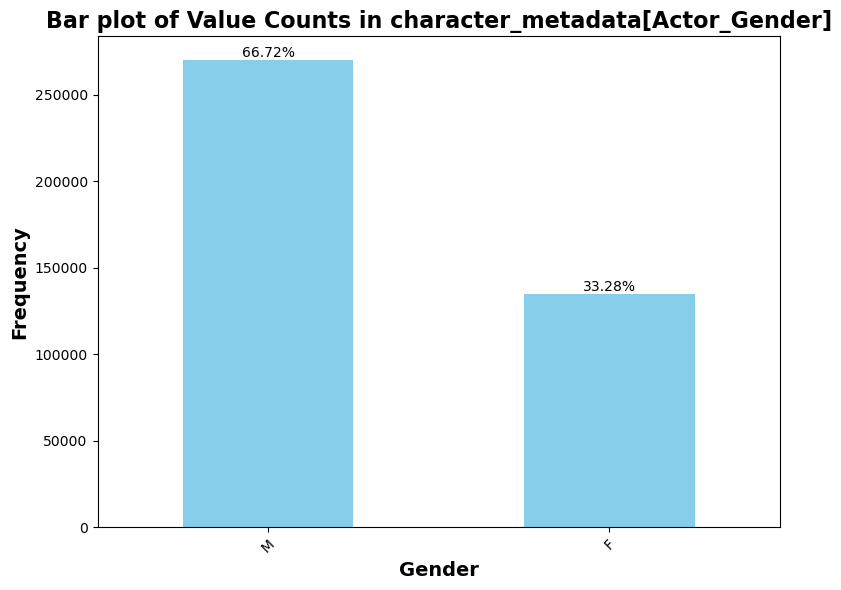

In [58]:
# Calculate gender counts
gender_count = character_metadata['Actor_Gender'].value_counts()

# Plot the gender distribution
plot_frequencie_proportion(
    data=gender_count,
    title="Bar plot of Value Counts in character_metadata[Actor_Gender]",
    xlabel="Gender"
)

##### Merging Data
Merge Actor_Gender and Actor_Freebase_ID on Wikipedia_ID of the movies_metadata in order to creat a DataFrame consisting of all movies associated with gendered actors

In [59]:
full_movie_metadata_actor_gender = full_movie_metadata.merge(
    character_metadata[['Wikipedia_ID', 'Actor_Gender', 'Actor_Freebase_ID']],
    on='Wikipedia_ID',
    how='left'
)

In [60]:
full_movie_metadata_actor_gender_american=full_movie_metadata_actor_gender[full_movie_metadata_actor_gender['Continents'].apply(lambda x: 'America'in x)]
gender_count_a=full_movie_metadata_actor_gender_american['Actor_Gender'].value_counts(dropna = False)
display(gender_count_a.head(30).to_frame().style.set_table_attributes('style="display:inline"').set_caption('<b>Actor Gender (America)</b>'))

full_movie_metadata_actor_gender_europe=full_movie_metadata_actor_gender[full_movie_metadata_actor_gender['Continents'].apply(lambda x: 'Europe'in x)]
gender_count_e=full_movie_metadata_actor_gender_europe['Actor_Gender'].value_counts(dropna = False)
display(gender_count_e.head(30).to_frame().style.set_table_attributes('style="display:inline"').set_caption('<b>Actor Gender (Europe)</b>'))

full_movie_metadata_actor_gender_both=full_movie_metadata_actor_gender[full_movie_metadata_actor_gender['Continents'].apply(lambda x: 'Both'in x)]
gender_count_b=full_movie_metadata_actor_gender_both['Actor_Gender'].value_counts(dropna = False)
display(gender_count_b.head(30).to_frame().style.set_table_attributes('style="display:inline"').set_caption('<b>Actor Gender (Both)</b>'))

,count
Actor_Gender,
M,52302
F,27092
nan,6978


,count
Actor_Gender,
M,11525
F,6013
nan,3336


,count
Actor_Gender,
M,6004
F,3374
nan,709


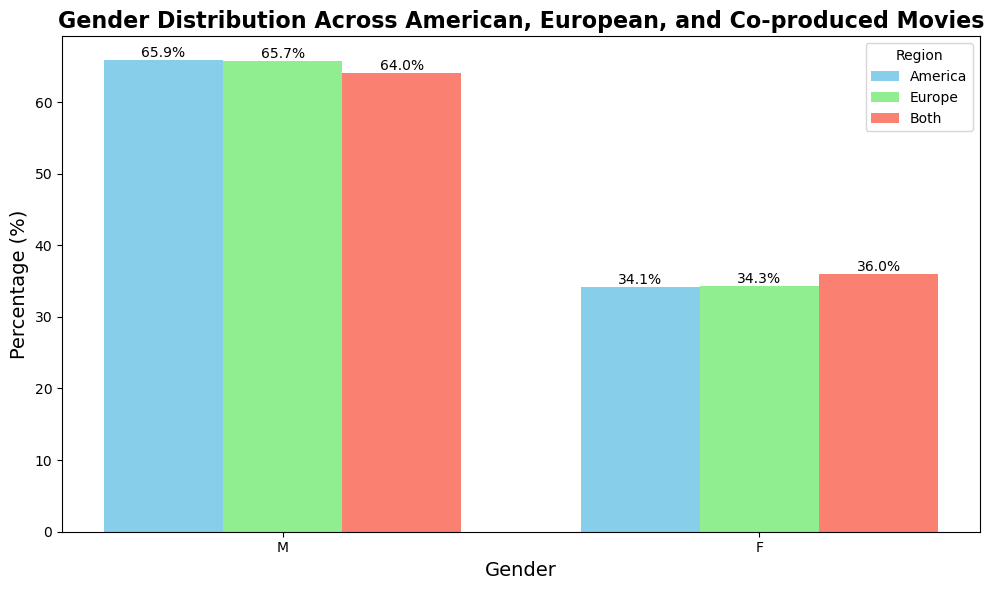

In [61]:
plot_gender_distribution_regions(
    data=full_movie_metadata_actor_gender,
    title="Gender Distribution Across American, European, and Co-produced Movies"
)

We see very similar proportions for gender repartition in European and American movies. <br>
Further reaserch will focus on:
- The evolution of this proportion at different time periods in the two movie industries.
- The types of comedies where a significantly different proportion is observed on the two contients.
- Look for correlations in movie recognition (boxoffice/rankings/ratings/awards) and gender repatition.

#### 2. Ethnicity

In [62]:
display(character_metadata['Actor_Ethnicity'].value_counts(dropna = False).head(10).to_frame().style.set_table_attributes('style="display:inline"').set_caption('<b>Actor Ethnicities</b>'))

,count
Actor_Ethnicity,
nan,344611
/m/0dryh9k,16351
/m/0x67,10159
/m/041rx,10121
/m/02w7gg,6165
/m/033tf_,3857
/m/0xnvg,2956
/m/02ctzb,2307
/m/07hwkr,2250


#### This huge proportion of NaN is an issue, the first future step for this part would be to focus on treating these NaN. Since actors appear multiple times in character_metadata, Actor_Ethnicity might be taken from other occurence of this actor in the data.
For now we just drop the NaN values

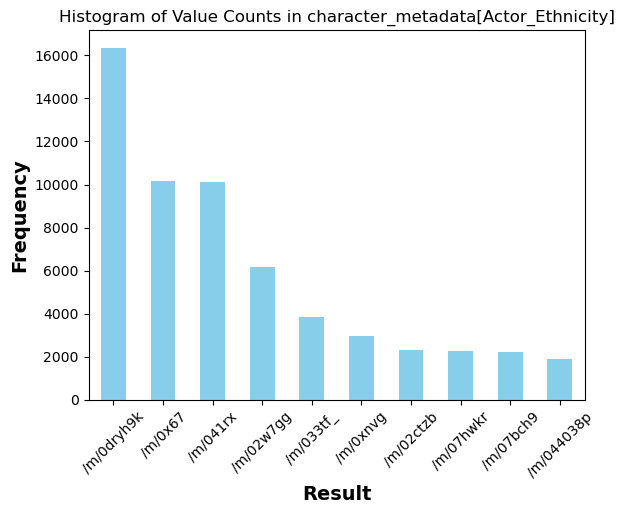

In [63]:
ethnicity_count=character_metadata['Actor_Ethnicity'].value_counts().head(10)
# Plot the histogram
ethnicity_count.plot(kind='bar', color='skyblue')
plt.title('Histogram of Value Counts in character_metadata[Actor_Ethnicity]')
plt.xlabel('Result', fontdict={'fontsize': 14, 'fontweight': 'bold'})
plt.ylabel('Frequency', fontdict={'fontsize': 14, 'fontweight': 'bold'})
plt.xticks(rotation=45)
plt.show()

All ethnicities are named with a Freebase_ID, we need to map Ethnicities to corresponding Freebase_ID

Load and treating the mappings of Freebase_ID to Ethnicity

In [64]:
ethnicity_map=pd.read_csv("data/ethnicity_mappings.csv")

# Add a leading slash to Freebase_ID in ethnicity_map
ethnicity_map['freebase_id'] = ethnicity_map['freebase_id'].apply(lambda x: f'/{x}' if not x.startswith('/') else x)
ethnicity_map.head(3)

,freebase_id,ethnicity
0,/m/0x67,African Americans
1,/m/064b9n,Omaha Tribe of Nebraska
2,/m/041rx,Jewish people


In [65]:
# Convert the ethnicity_map DataFrame into a dictionary for mapping
ethnicity_dict = ethnicity_map.set_index('freebase_id')['ethnicity'].to_dict()

# Map the Freebase IDs in character_metadata to their ethnicities
character_metadata['Actor_Ethnicity'] = character_metadata['Actor_Ethnicity'].map(ethnicity_dict)

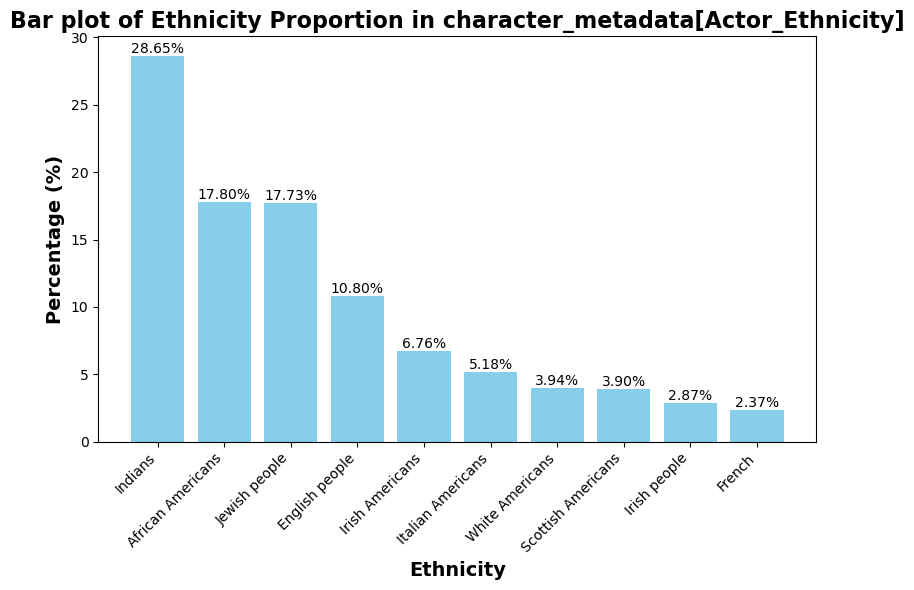

In [66]:
ethnicity_count=character_metadata['Actor_Ethnicity'].value_counts().head(10)
plot_proportion(ethnicity_count, "Bar plot of Ethnicity Proportion in character_metadata[Actor_Ethnicity]", "Ethnicity")

##### Merging Data
Merge Actor_Ethnicity and Actor_Freebase_ID on Wikipedia_ID of the movies_metadata in order to create a DataFrame consisting of all movies associated with informtaion about ethnicitiy of actors.

In [67]:
full_movie_metadata_actor_ethnic = full_movie_metadata.merge(
    character_metadata[['Wikipedia_ID', 'Actor_Ethnicity', 'Actor_Freebase_ID']],
    on='Wikipedia_ID',
    how='left'
)
full_movie_metadata_actor_ethnic.head(3)

,Wikipedia_ID,Movie_Name,Release_Date,Box_Office_Revenue,Runtime,Languages,Countries,Genres,Continents,Year,...,Response,totalSeasons,Oscar,Nomination_Awards,Win_Awards,Internet_Movie_Database_Rating,Rotten_Tomatoes_Rating,Metacritic_Rating,Actor_Ethnicity,Actor_Freebase_ID
0,13696889,The Gangsters,1913-05-29,NaN,35.0,"['Silent film', 'English Language']",['United States of America'],"['Short Film', 'Silent film', 'Indie', 'Black-...",['America'],1957,...,True,NaN,0,0,0,5.9,NaN,NaN,Scottish Americans,/m/0k57l
1,10408933,Alexander's Ragtime Band,1938-08-16,3600000.0,106.0,['English Language'],['United States of America'],"['Musical', 'Comedy', 'Black-and-white']",['America'],1938,...,True,NaN,1,6,1,6.8,8.3,NaN,NaN,/m/0pkw7
2,10408933,Alexander's Ragtime Band,1938-08-16,3600000.0,106.0,['English Language'],['United States of America'],"['Musical', 'Comedy', 'Black-and-white']",['America'],1938,...,True,NaN,1,6,1,6.8,8.3,NaN,French Americans,/m/02s58t


In [68]:
# Filter rows where 'Continents' is one of 'America', 'Europe', or 'Both'
full_movie_metadata_actor_ethnic_filtered = full_movie_metadata_actor_ethnic[full_movie_metadata_actor_ethnic['Continents'].apply(lambda x: 'America'in x or 'Europe' in x or 'Both' in x)]

In [69]:
full_movie_metadata_char_ethnic_american=full_movie_metadata_actor_ethnic[full_movie_metadata_actor_ethnic['Continents'].apply(lambda x: 'America'in x)]
ethnicity_count_a=full_movie_metadata_char_ethnic_american['Actor_Ethnicity'].value_counts()
display(ethnicity_count_a.head(5).to_frame().style.set_table_attributes('style="display:inline"').set_caption('<b>Actor Ethnicity (America)</b>'))

full_movie_metadata_char_ethnic_europe=full_movie_metadata_actor_ethnic[full_movie_metadata_actor_ethnic['Continents'].apply(lambda x: 'Europe'in x)]
ethnicity_count_e=full_movie_metadata_char_ethnic_europe['Actor_Ethnicity'].value_counts()
display(ethnicity_count_e.head(5).to_frame().style.set_table_attributes('style="display:inline"').set_caption('<b>Actor Ethnicity (Europe)</b>'))

full_movie_metadata_char_ethnic_both=full_movie_metadata_actor_ethnic[full_movie_metadata_actor_ethnic['Continents'].apply(lambda x: 'Both'in x)]
ethnicity_count_b=full_movie_metadata_char_ethnic_both['Actor_Ethnicity'].value_counts()
display(ethnicity_count_b.head(5).to_frame().style.set_table_attributes('style="display:inline"').set_caption('<b>Actor Ethnicity (Both)</b>'))

,count
Actor_Ethnicity,
Jewish people,4121
African Americans,4088
Irish Americans,1634
Italian Americans,1335
Scottish Americans,1089


,count
Actor_Ethnicity,
English people,829
Jewish people,292
Italians,239
French,205
White British,110


,count
Actor_Ethnicity,
English people,596
Jewish people,408
African Americans,254
Irish Americans,190
Italian Americans,183


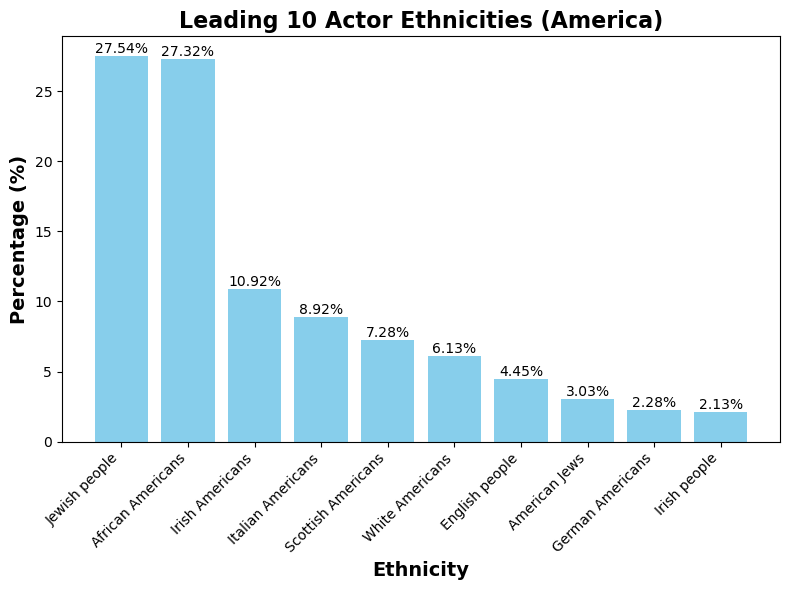

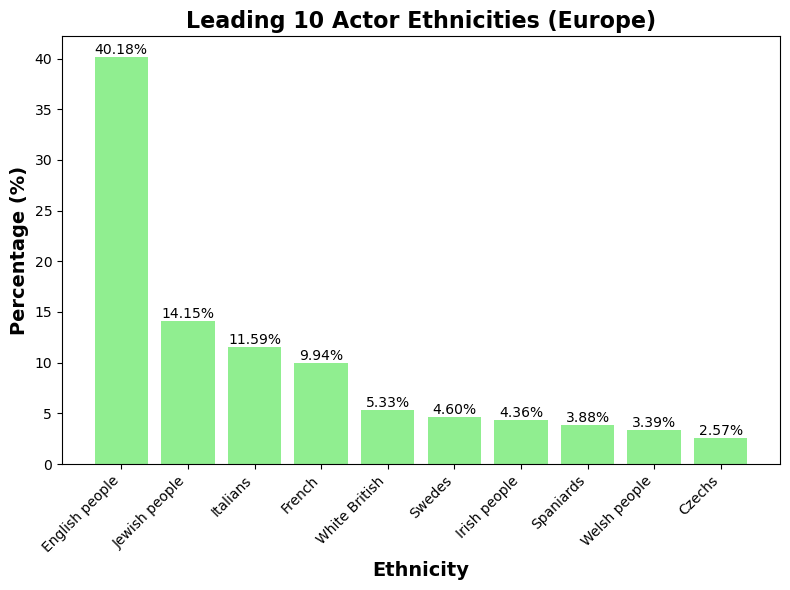

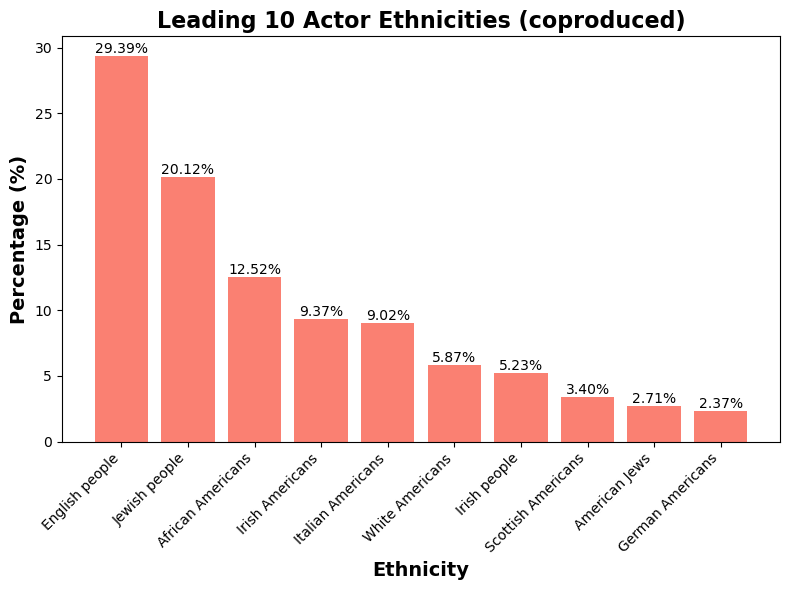

In [70]:
i=10
plot_proportion(ethnicity_count_a.head(i),title=f'Leading {i} Actor Ethnicities (America)', xlabel="Ethnicity",color='skyblue')
plot_proportion(ethnicity_count_e.head(i), title=f'Leading {i} Actor Ethnicities (Europe)', xlabel="Ethnicity",color='lightgreen')
plot_proportion(ethnicity_count_b.head(i), title=f'Leading {i} Actor Ethnicities (coproduced)', xlabel="Ethnicity",color='salmon')

We see very different proportions for ethic repartition of actors in European and American movies. <br>
Future step invole creating broader ethnic cathegories to have simplified but more accurate representation of the movie industry ethnic landscape.
Further reaserch will focus on:
- The evolution of these varying proportions at different time periods in the two movie industries.
- The types of comedies where a significantly different proportion is observed on the two contients.
- Look for correlations in movie recognition (boxoffice/rankings/ratings/awards) and ethnical diversity in the cast.

# Appendix
## Potential directions for future research (not required for Milestone 2)

In [ ]:
# Create copies of each row for each genre in the original genres list
rows = []
for _, row in merged_movie_metadata.iterrows():
    for genre in row['comedy_genres']:
        new_row = row.copy()
        new_row['comedy_genres'] = genre
        rows.append(new_row)

# Create a new DataFrame from the list of rows
exploded_df = pd.DataFrame(rows)

# Display the first few rows to verify the changes
display(exploded_df.head())

# Display the value counts of the 'comedy_genres' column
exploded_df["comedy_genres"].value_counts()
exploded_df.shape

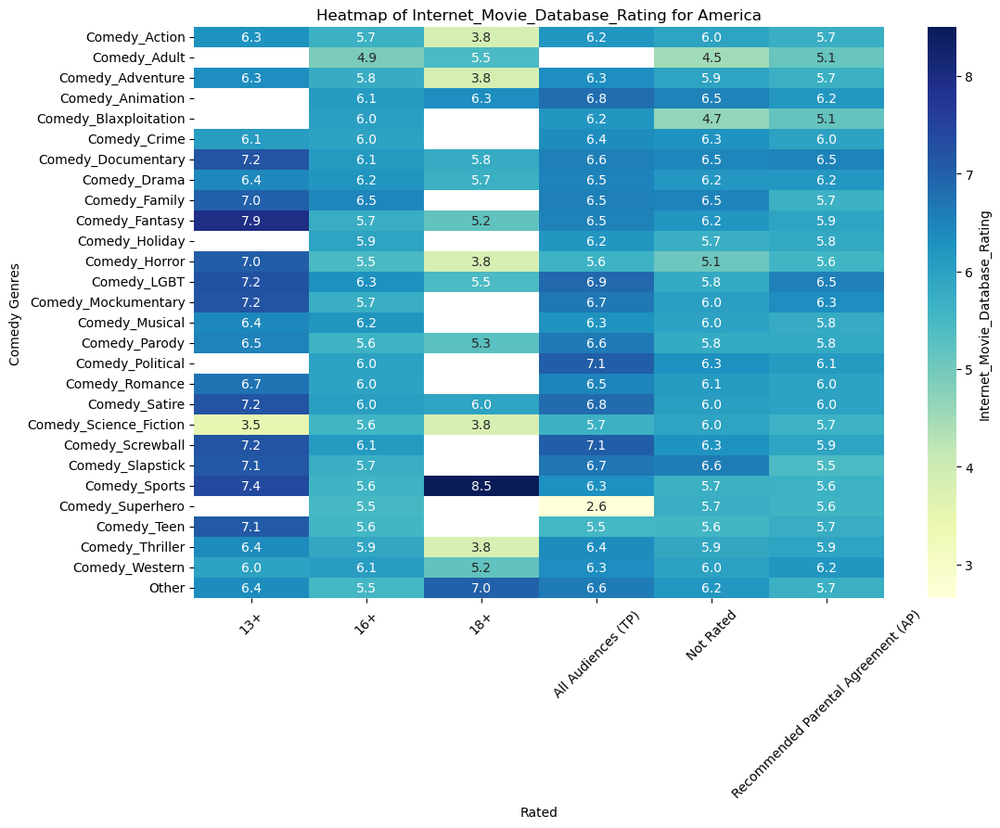

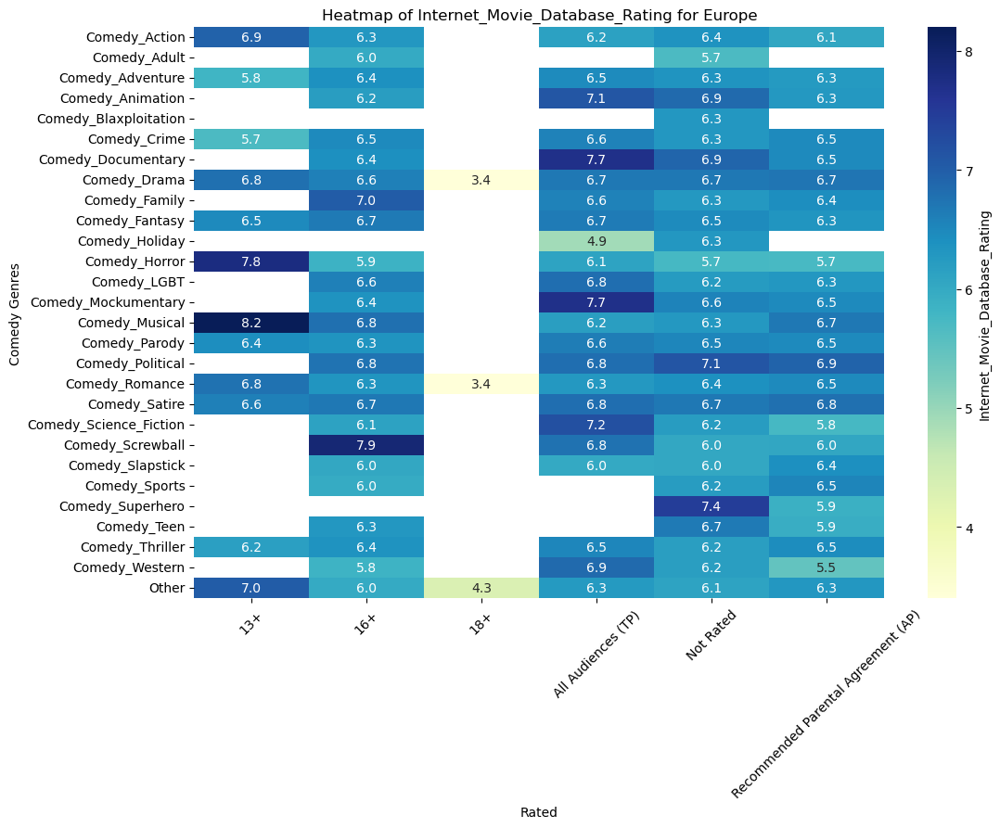

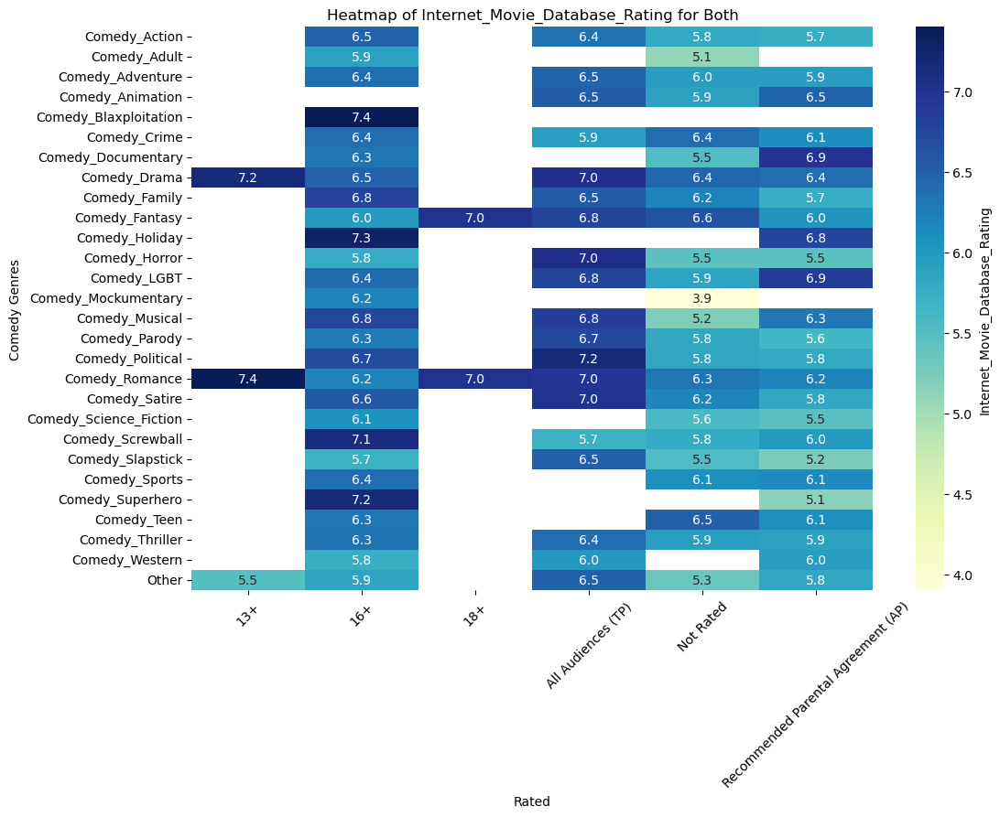

In [72]:
# Function to create heatmap for a given continent
def create_heatmap(continent):
    # Filter data for the given continent
    continent_data = exploded_df[exploded_df['Continents'].apply(lambda x: continent in x)]
    
    # Group by comedy genres and rated, then calculate the mean box office revenue
    heatmap_data = continent_data.groupby(['comedy_genres', 'Rated'])['Internet_Movie_Database_Rating'].mean().unstack()
    
    # Plot the heatmap
    plt.figure(figsize=(12, 8))
    sns.heatmap(heatmap_data, annot=True, fmt=".1f", cmap="YlGnBu", cbar_kws={'label': 'Internet_Movie_Database_Rating'})
    plt.title(f'Heatmap of Internet_Movie_Database_Rating for {continent}')
    plt.xlabel('Rated')
    plt.ylabel('Comedy Genres')
    plt.xticks(rotation=45)
    plt.yticks(rotation=0)
    plt.show()

# Create heatmaps for each continent
for continent in ['America', 'Europe', 'Both']:
    create_heatmap(continent)

In [73]:
# Explode the 'Types' column to have one type per row
exploded_dataset = dataset_Genre_Cleaned.explode('Types')

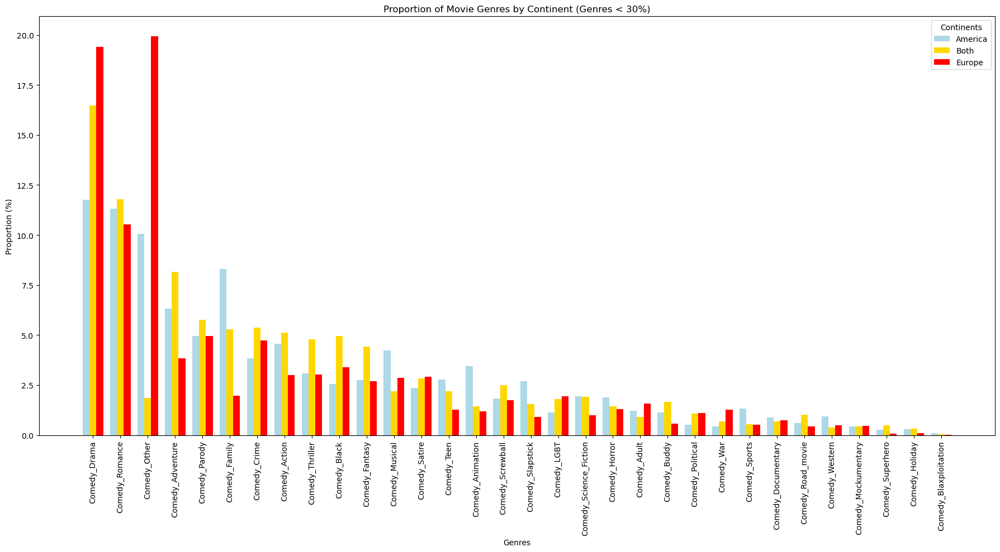

In [76]:
# Calculate the proportion of each genre by continent
genre_proportion_by_continent = exploded_dataset.groupby(['Continents', 'Types']).size().unstack().apply(lambda x: x / x.sum(), axis=1) * 100

# Filter to retain only genres where each continent has less than 10% proportion
threshold = 30
filtered_genre_proportion = genre_proportion_by_continent.loc[:, (genre_proportion_by_continent < threshold).all()]

# Sort genres by total proportion in descending order
total_proportions = filtered_genre_proportion.sum(axis=0).sort_values(ascending=False)
filtered_genre_proportion = filtered_genre_proportion[total_proportions.index]

# Initialize colors for each continent
colors = {
    'America': 'lightblue',
    'Both': 'gold',
    'Europe': 'red'
}

# Define the gap between the bars
bar_width = 0.25
x = np.arange(len(filtered_genre_proportion.columns))  # Positions for the filtered genres

# Create a figure for side-by-side bars
plt.figure(figsize=(18, 10))

# Plot bars for each continent
for i, (continent, color) in enumerate(colors.items()):
    if continent in filtered_genre_proportion.index:
        # Offset for each continent
        plt.bar(x + i * bar_width, filtered_genre_proportion.loc[continent], width=bar_width, color=color, label=continent)

# Set labels and title
plt.title('Proportion of Movie Genres by Continent (Genres < ' + str(threshold) + '%)')
plt.xlabel('Genres')
plt.ylabel('Proportion (%)')
plt.xticks(x + bar_width, filtered_genre_proportion.columns, rotation=90)
plt.legend(title='Continents', loc='upper right')

plt.tight_layout()
plt.show()


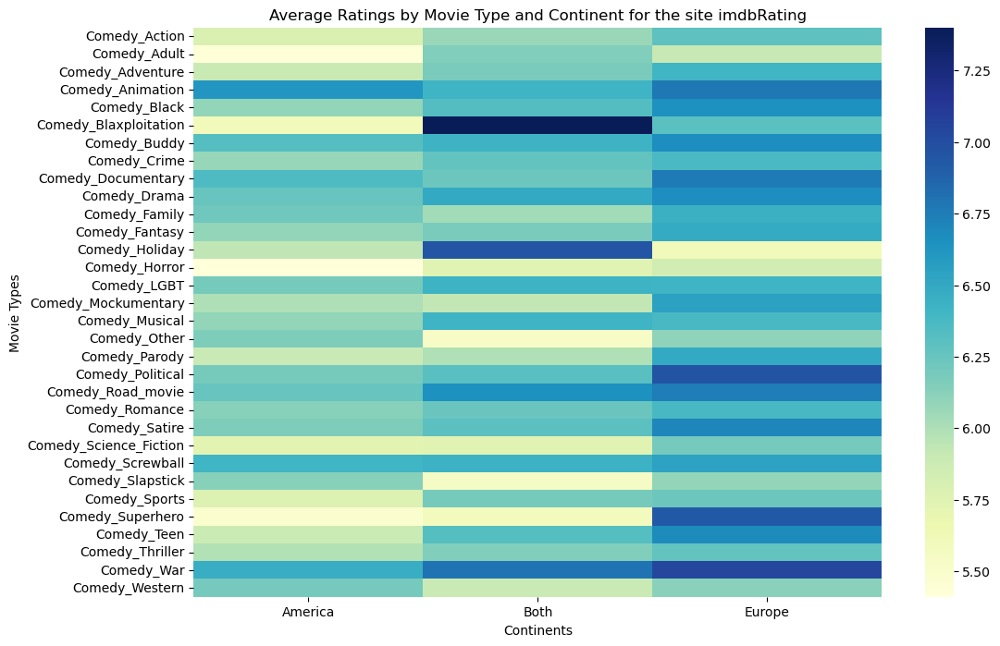

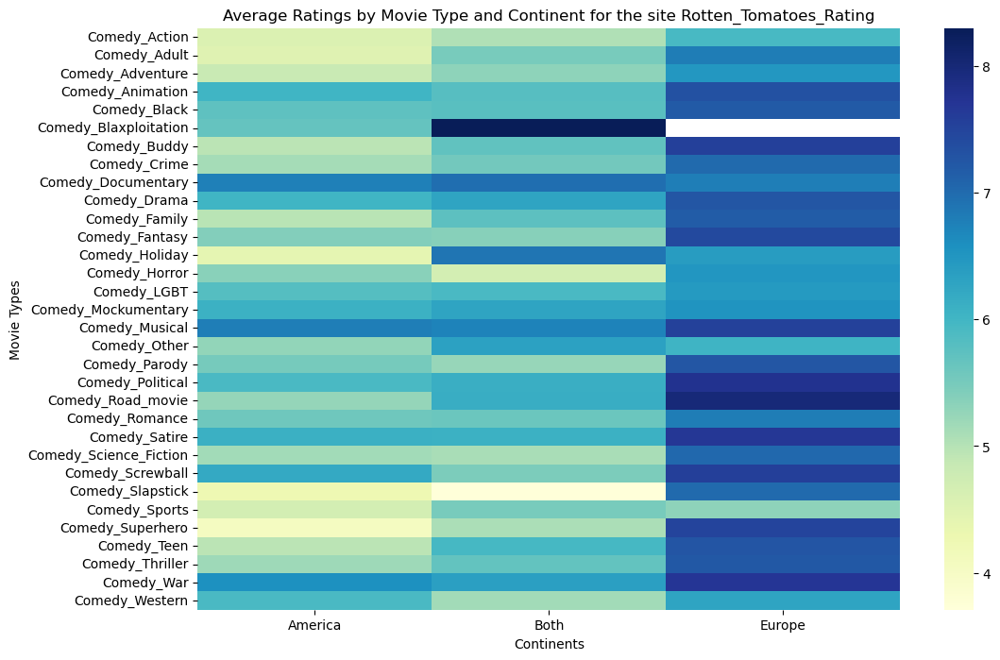

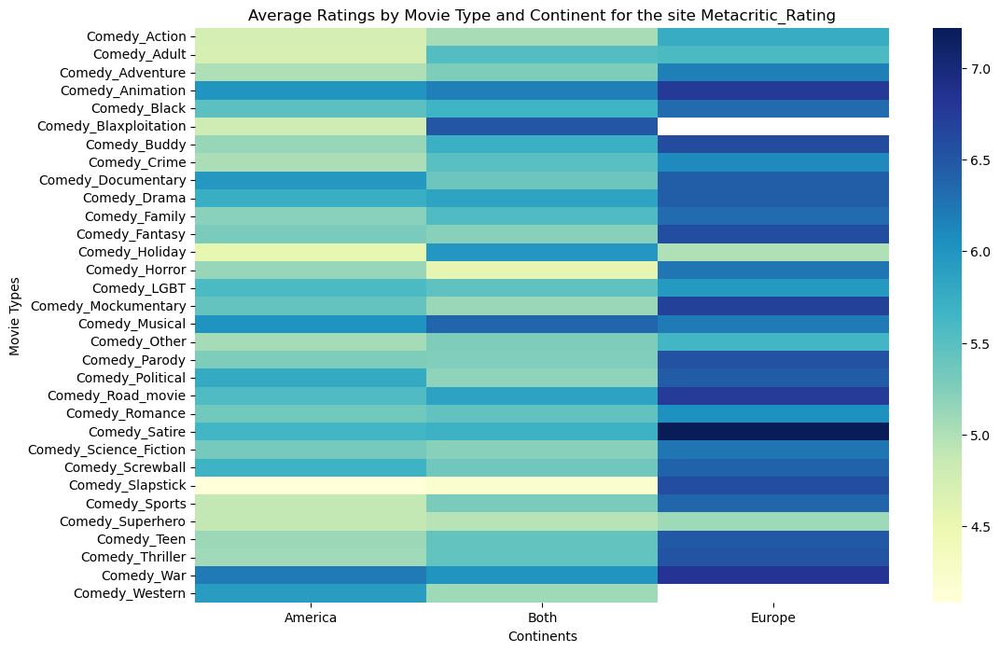

In [77]:
for rating in ratings_columns:    
    
    # Calculate the heatmap data based on 'Best_Rating'
    heatmap_data = exploded_dataset.groupby(['Types', 'Continents'])[rating].mean().unstack()
    
    plt.figure(figsize=(12, 8))
    sns.heatmap(
        heatmap_data,
        #annot=True,
        cmap="YlGnBu",
        #fmt=".1f",
        #cbar_kws={'label': 'Average Rating'},
        #annot_kws={"color": "black"}
    )
    plt.title(f"Average Ratings by Movie Type and Continent for the site {rating}")
    plt.xlabel("Continents")
    plt.ylabel("Movie Types")
    plt.show()